# Exploratory Data Analysis

## Brainstation Capstone Project

### Spencer Cox
### Summer, 2022
### Notebook Plan

With the corporate parcels geodatabase and the Twin Cities demographic, social, and economic indicators geodatabase cleaned, we will now shift towards exploratory data analysis, getting a greater understanding of the distribution of our attributes.

First, we will do exploratory analysis of our Twin Cities indicators geodatabase, examining visually the spatial organization of features and distributions. We will perform some basic statistical tests assessing spatial randomness.

We will then analyse the point parcel dataset, visualizing the distribution of corporate housing across the Twin Cities region. We will also conduct basic statistical analysis to understand if the distribution of corporate housing is randomly allocated across space or displays particular clustering behavior. 


In [1]:
# Import key packages for data pre-processing

import fiona
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
import seaborn as sns
import contextily as cx


# Set options
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.options.mode.chained_assignment = None  # default='warn'

## Twin Cities Social, Economic, Housing, and Demographic Attributes

In [2]:
# Load our cleaned and pre-processed dataset

tc_gdf = gpd.read_file('twincities_tracts.gpkg')

In [3]:
#shape
print(f'The dataframe has {tc_gdf.shape[0]} tracts and {tc_gdf.shape[1]} attributes.')

The dataframe has 703 tracts and 43 attributes.


In [4]:
# Geographic Information
tc_gdf.crs

<Derived Projected CRS: EPSG:26915>
Name: NAD83 / UTM zone 15N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: North America - between 96°W and 90°W - onshore and offshore. Canada - Manitoba; Nunavut; Ontario. United States (USA) - Arkansas; Illinois; Iowa; Kansas; Louisiana; Michigan; Minnesota; Mississippi; Missouri; Nebraska; Oklahoma; Tennessee; Texas; Wisconsin.
- bounds: (-96.0, 25.61, -90.0, 84.0)
Coordinate Operation:
- name: UTM zone 15N
- method: Transverse Mercator
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [5]:
#peak
tc_gdf.head()

,TR10,CTU_PRMRY,POPTOT_MC,AGE_DIV,IMM_DIV,RACIAL_DIV,PBLACKNH,PPOV185,ACP,PPOV500,ACA,TR_EDA,INCOME_DIV,INC_CHG,OE_BC,NE_LW,NE_MW,NE_HW,PHFTRANSIT,COMMLENGTH,PCOMMTRANS,PJOB_LT5,TR_EJ,ENV_PM25,PMV,NBR_STAB,POWNHOME,PCOSTBURD,RP_NETCHG,TR_QUALIF,OWNER_RATIO,RENT_CHG,EMV_CHG,AFF_CHG,TR_PARCELSALL,TR_SINGLEFAMTOT,TR_SNGLFAM_CORP,TR_MULTIFAM_ALL,MFOWN_NOTMN,MED_YRBUILT,RATIO_CORPSF,RATIO_NOTMNMF,geometry
0,27003050107,St. Francis,3034.0,0.699942,0.000000,0.076826,0.000,0.231,0.0,0.205,0.0,0.0,0.750102,6.059419,0.268156,0.299441,0.311173,0.121229,0.0,37.12,0.000,0.307,0.0,6.907,0.062,1.148986,0.922,0.296,33.0,0.0,0.887350,25.000000,24.462236,-42.657741,840.0,833.0,22.0,7.0,0.0,1999.0,0.026411,0.0,"POLYGON ((466670.793 5025804.948, 466568.869 5..."
1,27003050108,St. Francis,5525.0,0.714851,0.105732,0.235573,0.021,0.161,0.0,0.295,0.0,0.0,0.767542,27.359351,0.291538,0.273039,0.306954,0.128469,0.0,32.92,0.011,0.315,0.0,6.914,0.120,0.820704,0.840,0.204,243.0,0.0,0.815470,8.437500,25.451200,-42.808414,1924.0,1904.0,41.0,20.0,0.0,1999.0,0.021534,0.0,"POLYGON ((474792.463 5028953.926, 474818.440 5..."
2,27003050109,East Bethel,5720.0,0.778142,0.035470,0.133992,0.004,0.118,0.0,0.401,0.0,0.0,0.775221,-3.425043,0.267959,0.301971,0.296567,0.133503,0.0,34.44,0.010,0.219,0.0,6.941,0.054,1.313127,0.927,0.148,111.0,0.0,0.933000,48.837209,28.765990,-58.566323,1950.0,1943.0,35.0,7.0,0.0,1989.0,0.018013,0.0,"POLYGON ((488872.762 5027577.808, 488874.904 5..."
3,27003050110,East Bethel,2713.0,0.838476,0.029669,0.087429,0.000,0.124,0.0,0.452,0.0,0.0,0.787445,-1.953461,0.254967,0.305960,0.303311,0.135762,0.0,31.40,0.003,0.268,0.0,7.105,0.090,1.477267,0.940,0.137,165.0,0.0,0.895582,-0.808229,29.537197,-55.706406,939.0,931.0,31.0,8.0,0.0,1987.0,0.033298,0.0,"POLYGON ((483830.438 5016030.425, 482806.514 5..."
4,27003050111,East Bethel,3751.0,0.773435,0.047213,0.100611,0.009,0.091,0.0,0.440,0.0,0.0,0.773256,1.390666,0.286686,0.257046,0.310496,0.145773,0.0,37.30,0.014,0.267,0.0,7.078,0.089,1.231056,0.941,0.099,28.0,0.0,0.879477,-13.536776,27.363291,-55.568749,1636.0,1631.0,24.0,5.0,0.0,1977.0,0.014715,0.0,"POLYGON ((487811.646 5015967.836, 487567.338 5..."


### Create Visualization Tools

#### Choropleths
Choropleths will be useful for understanding the spatial distribution of our attributes, which we'll explore and analyse in kind. Choropleth maps are useful for understanding the spatial distribution of continuous variables, using different break systems to categorize data into different groups. We will use the Fisher Jenks natural breaks classification algorithm which seeks to reduce the variance within classes and maximize the variance between classes (more description [here](https://en.wikipedia.org/wiki/Jenks_natural_breaks_optimization)).

#### Categorical Maps
Categorical maps are used to visualize the spatial organization of categorical data.



In [6]:
# Create a function for choropleth maps using the Fisher Jenks class method

def choro(df, column):

# Create basics for choropleth map using Fisher Jenks classification method and blues color scheme
    ax = df.plot(
        figsize = (12,12),
        alpha =0.55,                   # Transparency over basemap
        column = column,               # Data Plot
        scheme = 'fisherjenks',        # Classification scheme
        cmap = 'Reds',                # Color Palette
        edgecolor = 'k',               # Borderlin color
        linewidth=0.1,                 # Borderline width
        legend = True                 # Legend
    )
    ax.set_title(column)
    ax.set_axis_off()

# Add a basemap, with basemap's coordinate system aligned with our geodataframe, with labels
    cx.add_basemap(ax, crs=df.crs, source=cx.providers.Stamen.TonerLite)
    cx.add_basemap(ax, source=cx.providers.Stamen.TonerLabels, zoom=10)

In [7]:
# Create a function for categorical maps
def cat_map(df, column):

#Create outline for a categorical map.
    
    ax = df.plot(
        figsize = (12, 12),
        alpha =0.55,
        edgecolor = 'k',
        linewidth=0.1,
        column = column,
        legend = True,
        missing_kwds={
            "color": "lightgrey",
            "edgecolor": "red",
            "hatch": "///",
            "label": "Missing values"}
        )
        
    ax.set_title(column)
    ax.set_axis_off()
        
 # Add a basemap, with basemap's coordinate system aligned with our geodataframe, with labels
    cx.add_basemap(ax, crs=df.crs, source=cx.providers.Stamen.TonerLite)
    cx.add_basemap(ax, source=cx.providers.Stamen.TonerLabels, zoom=10)   


#### Local Autocorrelation
Local Autocorrelation leverages the Moran Statistic to assess spatial autocorrelation of a variable across space. The Moran I statistic is calculated:
$$
I = \dfrac{n}{\sum_i\sum_j w_{ij}} \dfrac{\sum_i\sum_j w_{ij} \, z_i \, z_j}{\sum_i z_i^2}
$$

where $n$ is the  number of observations, $z_{i}$ is the standardized value of the variable of interest at location $i$, and $w_{ij}$ is the cell corresponding to the $i$-th row and $j$-th column of a $W$ spatial weights matrix.

The logic of the Moran Statistic is better udnerstood through the Moran Plot (see the notebook by [Arribas-Bel](http://localhost:8890/notebooks/Documents/Brainstation/Capstone/textbooks/Geo_Data_Science/06_spatial_autocorrelation.ipynb) detailing its use, or the ARCGIS page [here](https://pro.arcgis.com/en/pro-app/2.8/tool-reference/spatial-statistics/h-how-spatial-autocorrelation-moran-s-i-spatial-st.htm). The Moran Plot is a way of visualizing a spatial dataset to explore the nature and strength of spatial autocorrelation to asssess if a feature demonstrates clusters or is more scattered across space (is there a spatial pattern or is it random). It is essentially a traditional scatter plot in which the variable of interest is displayed against its *spatial lag*.

In other words, reading local autocorrelation charts show us where two attributes are tightly correlated between neighboring spatial features (either positively or negatively), or, conversely where there is little spatial relation between neighboring spatial features.

In general, we would like to see high levels of spatial autocorrelation for our features, for it demonstrates that the feature can have some predictive value in understanding the spatial patterns of our target variable when we move to modeling.


In [8]:
# Local Autocorrelation

from splot.esda import plot_local_autocorrelation
import libpysal as lps
import esda

def local_autocorrelation(df, column):
        wq =  lps.weights.Queen.from_dataframe(df)
        li = esda.moran.Moran_Local(df[column], wq)
        plot_local_autocorrelation(li, df, column)

For example, looking at the local autocorrelation between New Economy Low Wage jobs on the Moran local scatterplot shows tracts where there is strong high/high values in neighboring tracts (HH) and strong low/low variables in neighboring tracts (LL), or in otherwords more spatially clustered attributes. These parcels have a Moran I test stat p-value below .05, rejecting the null hypothesis that the attribute is randomly distributed spatially. LIkewise, it shows high next to low (HL), or low next to high (LH), or areas marked by transition from one to the other. NS are areas with local autocorrelation. We can view these scatterplots then spatially to show where clusters for that attribute exist.

In the below example, we can see that there are clusters for people who work in low wage service and transport jobs (HH) in the city center, surrounded by urban areas with few people in the cluster (LL), and again first ring suburban clusters in 'working class' suburbs comapred to 'wealthy' suburbs (HH again). In others, there is little spatial clustering.

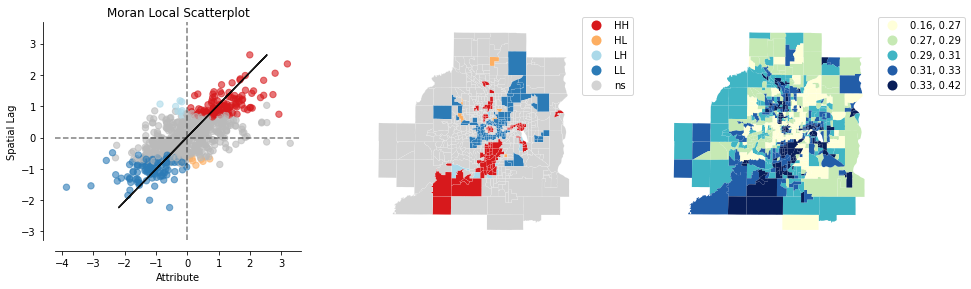

In [9]:
local_autocorrelation(tc_gdf, 'NE_LW')

## EDA of Target Variables

With our visualization toolkit in place, let us start to get a picture of spatial patterns in the Twin Cities that may have predictive value in our modeling of assessing the odds of a parcel being purchased and owned by a corporate investor.

Here is the data dictionary for our key variables, each organized under particular categories that we will approach together to create some overview of the region:

Identifiers
- `TR10`	Identifier for tract (2010 vintage)
- `CTU_PRMRY`Primary city/township (with a plurality of the tract's population)

Demographic Indicators
- `POPTOT_MC`	Total population (Metropolitan Council estimate)
- `AGE_DIV` Age diversity index
- `IMM_DIV` - Immigration Diversity index 
- `RACIAL_DIV` - A racial diversity index to capture the racial diversity of a neighborhood
- `PBLACKNH`	Proportion of residents who identify as Black or African American, non-Latino

Economic Indicators
- `PPOV185`	People whose family income is less than 185% of the federal poverty threshold, as a proportion of all people for whom poverty status is determined
- `ACP`	1 if Area of Concentrated Poverty (excludes tracts where PSTUDENT>=0.5 OR PPOV_STUDENT>=0.333 from the set of tracts where CONCPOV=1); 0 otherwise
- `PPOV500`	% of people whose income is at least 500% of the federal poverty threshold
- `ACA`	1 if Area of Concentrated Affluence (PPOV500_RAT >= 1.667 OR MD_EMV_RAT >= 1.667); 0 otherwise
- `TR_EDA`	Economically "Distressed" Area according to U.S. Economic Development Administration (1 = yes; 0 = no)
- `INCOME_DIV` - An income diversity index to capture the income diversity of a neighborhood
- `INC_CHG` - Measures percent change in household income
- `OE_BC` - Measures residential density of people who work in 'Old Economy Blue Collar' Occupations
- `NE_LW` - Measures residential density of people who work in 'New Economy Low Wage' Occupations
- `NE_MW` - Measures residential density of people who work in 'New Economy Medium Wage' Occupations
- `NE_HW` - Measures residential density of people who work in 'New Economy High Wage' Occupations


Commute Indicators
- `PHFTRANSIT`	Proportion of residents living within one-half mile of high-frequency transit
- `COMMLENGTH`	Mean commute length (in minutes)
- `PCOMMTRANS`	Proportion of commuters who took public transportation to work
- `PJOB_LT5`	Proportion of jobs held by workers who live less than 5 miles away (primary jobs only; excludes second or third jobs)

Environmental Indicators
- `TR_EJ`	Area of Environmental Justice Concern (1 = yes; 0 = no)
- `ENV_PM25`	Fine particulate matter (2.5 microns or less) (annual average micrograms per cubic meter); air quality standard is 12

Housing Indicators
- `PMV`	Proportion who moved to current housing unit in the last year (out of residents age 1+)
- `NBR_STAB`	Neighborhood Stability
- `POWNHOME`	Homeownership rate
- `PCOSTBURD`	% housing cost-burdened (housing costs are 30%+ of household income)
- `RP_NETCHG`	Net change in number of housing units, 2010-2019
- `TR_QUALIF`	Low-Income Housing Tax Credit Qualified Census Tract (1 = yes; 0 = no)
- `OWNER_RATIO` - Ratio of homeowners as proportion of total households
- `RENT_CHG` - Measures percent change rent
- `EMV_CHG` - Measures percent change in market value
- `AFF_CHG` - Measures percent change in deep affordability

Parcel Derived Variables
- `TR_PARCELSALL` - All Parcels in the Tract
- `TR_SINGLEFAMTOT` - All Single Family Parcels in the Tract
- `TR_SNGLFAM_CORP` - All Single Family Parcels owned by a corporation in the Tract
- `TR_MULTIFAM_ALL` - All Multifamily in the tract
- `MFOWN_NOTMN` - All Multifamily owned by out of state taxpayer
- `MED_YRBUILT` - Median year built of parcels in the tract
- `RATIO_CORPSF` - `TR_SNGLFAM_CORP`/`TR_SINGLEFAMTOT` - ratio of all single family parcels owned by a corporation
- `RATIO_NOTMNMF` - `MFOWN_NOTMN`/`TR_MULTIFAM_ALL` - ratio of all multifamily parcels in the tract owned out of state

- `geometry` Contains the geographical information for the polygon


## Correlation Across the DF

Prior to beginning, we will visualize the correlation matrix to see the overall relationship between variables, while also providing information for later visualizations.

In [10]:
def display_correlation(df):
    r = df.corr()
    plt.figure(figsize=(20,20))
    heatmap = sns.heatmap(df.corr(), vmin=-1, 
                      vmax=1, annot=True, cmap = 'coolwarm')
    plt.title("Pearson Correlation")
    return(r)

In [11]:
def corr_pairs(df, column):
    
    #create correlation df
    df_corr = df.corr()
    
    #pull out the top 6 correlations for the column
    top5 = df_corr[column].sort_values(ascending = False).head(6)
    
    # Remove self-correlation
    top5.drop([column], axis = 0, inplace=True)

    # Pull out the bottom 5 correlations for the column
    bot5 = df_corr[column].sort_values(ascending = False).tail(5)
    
    #concat
    corr_pairs = pd.concat([top5, bot5])
    
    # To Dataframe
    corr_pairsdf = corr_pairs.to_frame()
    
    # Reset Index
    corr_pairsdf = corr_pairsdf.reset_index()
    
    #
    corr_pairsdf = corr_pairsdf.rename(columns = {'index': 'Attribute', column: 'Pearson'})
    
    #graph
    x = corr_pairsdf['Attribute'] 
    y = corr_pairsdf['Pearson']

    plt.plot(figsize = (9,5))
    plt.barh(x,y,color = (corr_pairsdf['Pearson']>0).map({True: 'gold', False: 'r'}))
    plt.xlabel('Perason Coefficient')
    plt.ylabel('Category')
    plt.title(f'Top & Bottom Pearson Correlation Coefficients for {column}')
    plt.gca().invert_yaxis()
    plt.show()


,POPTOT_MC,AGE_DIV,IMM_DIV,RACIAL_DIV,PBLACKNH,PPOV185,ACP,PPOV500,ACA,TR_EDA,INCOME_DIV,INC_CHG,OE_BC,NE_LW,NE_MW,NE_HW,PHFTRANSIT,COMMLENGTH,PCOMMTRANS,PJOB_LT5,TR_EJ,ENV_PM25,PMV,NBR_STAB,POWNHOME,PCOSTBURD,RP_NETCHG,TR_QUALIF,OWNER_RATIO,RENT_CHG,EMV_CHG,AFF_CHG,TR_PARCELSALL,TR_SINGLEFAMTOT,TR_SNGLFAM_CORP,TR_MULTIFAM_ALL,MFOWN_NOTMN,MED_YRBUILT,RATIO_CORPSF,RATIO_NOTMNMF
POPTOT_MC,1.000000,-0.190369,-0.014508,-0.083457,-0.160737,-0.189915,-0.125429,0.232795,0.057404,-0.138931,0.010418,-0.131606,0.144834,-0.127225,-0.182812,0.109215,-0.229747,0.154992,-0.222523,-0.070964,-0.158980,-0.302147,-0.070877,0.000285,0.189315,-0.160986,0.555757,-0.142956,0.177727,0.003570,-0.241731,-0.089546,0.861778,0.844817,0.440694,-0.054337,0.098075,0.199253,-0.075339,0.107972
AGE_DIV,-0.190369,1.000000,-0.207032,-0.161789,-0.248710,-0.152610,-0.327082,0.051402,-0.079262,-0.239061,0.255538,-0.001792,-0.292054,-0.230553,0.038566,0.316713,0.143584,-0.367000,0.112503,-0.093263,-0.223100,0.201886,0.391528,-0.093583,-0.298873,0.005802,0.102606,-0.174463,-0.269657,0.042245,-0.156464,0.045163,-0.208077,-0.219847,-0.181136,0.181106,0.127477,-0.239242,-0.000427,0.015929
IMM_DIV,-0.014508,-0.207032,1.000000,0.827973,0.656627,0.673828,0.549352,-0.588126,-0.200638,0.539791,-0.288180,0.170542,-0.228725,0.396145,0.248031,-0.257283,0.327021,-0.137057,0.442105,0.043442,0.663059,0.452812,0.360872,-0.505818,-0.570408,0.556430,-0.006959,0.577234,-0.575024,0.030070,0.434960,0.235105,-0.295586,-0.315331,0.008837,0.289303,0.181034,-0.028947,0.287179,0.059425
RACIAL_DIV,-0.083457,-0.161789,0.827973,1.000000,0.707819,0.719790,0.511591,-0.748910,-0.335493,0.557905,-0.161332,0.141205,-0.218017,0.489924,0.290635,-0.352548,0.374227,-0.178304,0.484074,0.080998,0.711855,0.538845,0.406424,-0.558427,-0.591000,0.598099,-0.056656,0.580967,-0.569587,-0.008051,0.544599,0.197823,-0.339305,-0.361046,0.055970,0.322312,0.210543,-0.146580,0.344222,0.003884
PBLACKNH,-0.160737,-0.248710,0.656627,0.707819,1.000000,0.721010,0.642520,-0.642838,-0.245188,0.548268,-0.357982,0.213284,-0.194850,0.464846,0.350803,-0.399688,0.450726,-0.063897,0.523756,0.091131,0.671897,0.427319,0.320314,-0.449051,-0.571868,0.595208,-0.104126,0.603526,-0.560301,-0.018194,0.529276,0.236073,-0.378664,-0.392217,-0.005118,0.246294,0.139837,-0.168124,0.339776,-0.020290
PPOV185,-0.189915,-0.152610,0.673828,0.719790,0.721010,1.000000,0.744939,-0.804040,-0.320487,0.689511,-0.416798,0.208103,-0.199609,0.513820,0.478575,-0.521570,0.527344,-0.018906,0.646783,0.153670,0.760740,0.498814,0.518003,-0.588850,-0.714886,0.839712,-0.081344,0.778021,-0.739065,-0.013328,0.633877,0.324492,-0.491728,-0.522284,0.011574,0.457025,0.212833,-0.031849,0.524760,-0.080393
ACP,-0.125429,-0.327082,0.549352,0.511591,0.642520,0.744939,1.000000,-0.518830,-0.125497,0.629613,-0.472994,0.146903,-0.153430,0.416809,0.326601,-0.382732,0.433428,0.082046,0.505675,0.154732,0.650385,0.317578,0.290683,-0.383337,-0.485570,0.576676,-0.115532,0.744833,-0.496823,-0.020106,0.516859,0.320768,-0.329174,-0.350397,0.035602,0.314076,0.120049,-0.068419,0.415222,-0.071107
PPOV500,0.232795,0.051402,-0.588126,-0.748910,-0.642838,-0.804040,-0.518830,1.000000,0.565392,-0.575633,0.067757,-0.120341,-0.059588,-0.661323,-0.346977,0.695464,-0.364721,0.053019,-0.454613,-0.110855,-0.642343,-0.388879,-0.424909,0.523495,0.654310,-0.663434,0.183054,-0.602132,0.621156,0.047655,-0.639958,-0.153734,0.478796,0.501307,-0.013758,-0.368330,-0.184620,0.224989,-0.390334,0.086540
ACA,0.057404,-0.079262,-0.200638,-0.335493,-0.245188,-0.320487,-0.125497,0.565392,1.000000,-0.169674,-0.352189,0.029221,-0.146344,-0.321525,-0.212696,0.455462,-0.137462,-0.005908,-0.135454,-0.025431,-0.182111,-0.125804,-0.163708,0.181703,0.255933,-0.238005,0.071018,-0.161058,0.234215,-0.041425,-0.327883,0.065745,0.139669,0.147686,-0.041404,-0.122804,-0.057473,0.048004,-0.121422,0.052602
TR_EDA,-0.138931,-0.239061,0.539791,0.557905,0.548268,0.689511,0.629613,-0.575633,-0.169674,1.000000,-0.324880,0.125025,-0.062936,0.

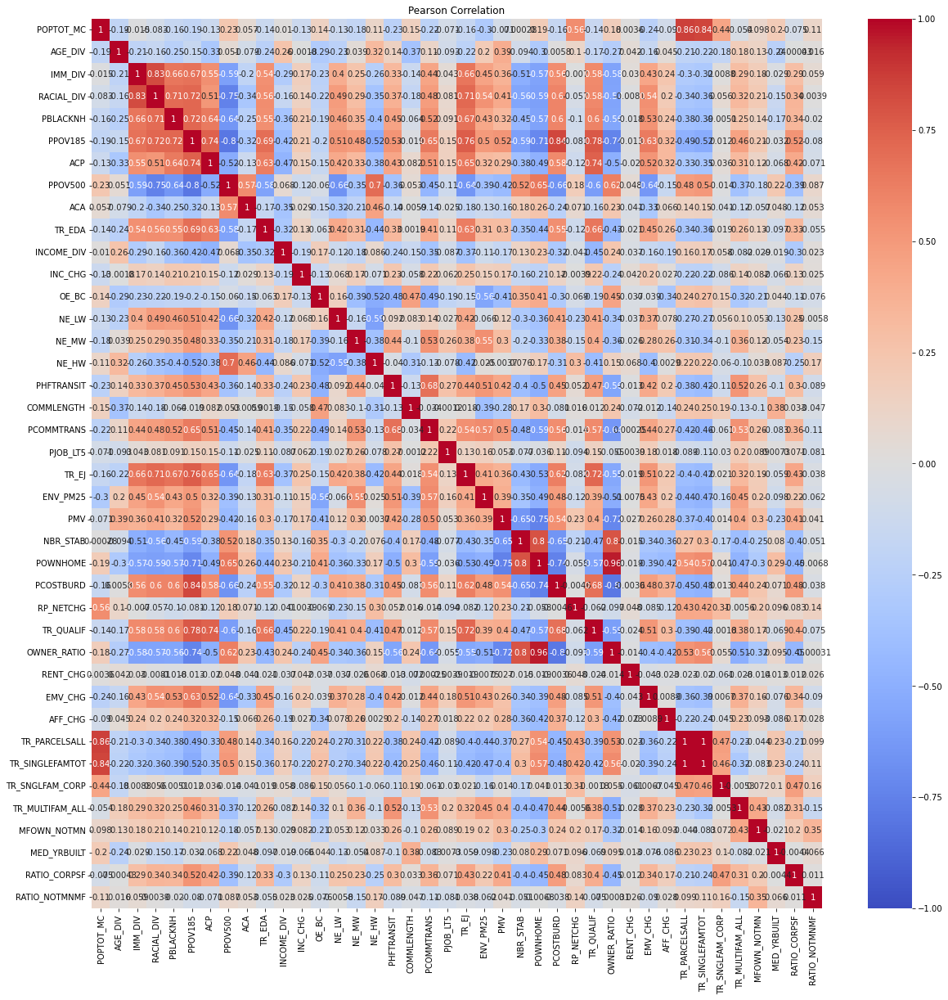

In [12]:
display_correlation(tc_gdf)

### Demographic Variables

- `AGE_DIV` Age diversity index
- `IMM_DIV` - Immigration Diversity index 
- `RACIAL_DIV` - A racial diversity index to capture the racial diversity of a neighborhood
- `PBLACKNH`	Proportion of residents who identify as Black or African American, non-Latino

#### Age Diversity

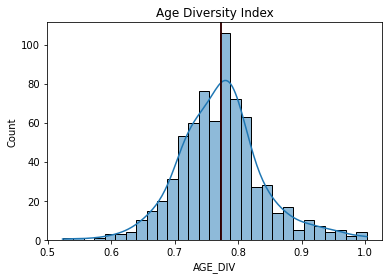

In [13]:
# General Distribution of the Age Diversity Index - very normally distributed
sns.histplot(x=tc_gdf['AGE_DIV'], kde=True)
plt.title('Age Diversity Index')
plt.axvline(tc_gdf['AGE_DIV'].mean(), color = 'red')
plt.axvline(tc_gdf['AGE_DIV'].median(), color = 'k')

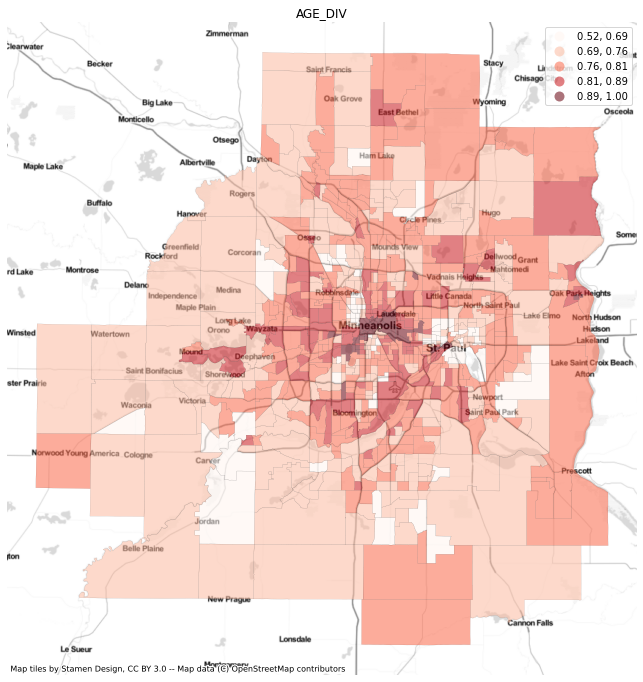

In [14]:

# Choropleth Map - Higher age diversity in the center of the Minneapolis, however less so in St Paul.
choro(tc_gdf, 'AGE_DIV')

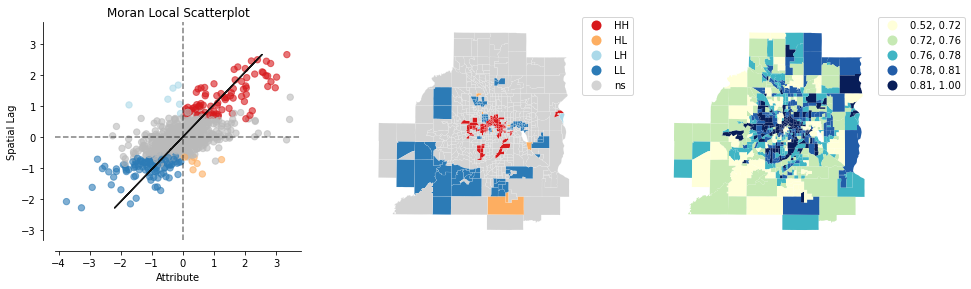

In [15]:
#Local Autocorrelation
local_autocorrelation(tc_gdf, 'AGE_DIV')

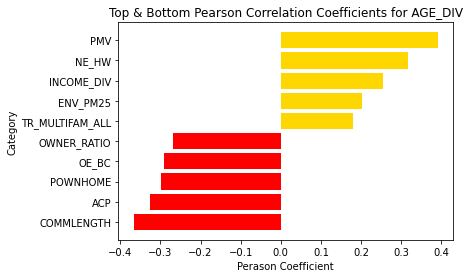

In [16]:
corr_pairs(tc_gdf, 'AGE_DIV')

The spatial patterns demonstrate that the inner city areas tend to have higher age diversity (a range of age groups), with outer suburbs significantly less so, with outersuburbs skewing younger. Interesting, there are also clusters of lower age diversity in neighborhoods near each downtown that tend to be higher ratios of those who identify as people of color (POC).

#### Immigrant Diversity

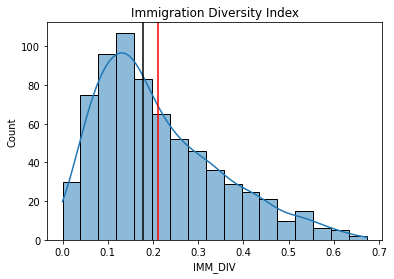

In [17]:
# General Distribution of the Age Diversity Index - Skews right, showing that there tend to be more neighborhoods
# marked by lower levels of immigrant diversity, with a handful of tracts with higher diversity
sns.histplot(x=tc_gdf['IMM_DIV'], kde=True)
plt.title('Immigration Diversity Index')
plt.axvline(tc_gdf['IMM_DIV'].mean(), color = 'red')
plt.axvline(tc_gdf['IMM_DIV'].median(), color = 'k')

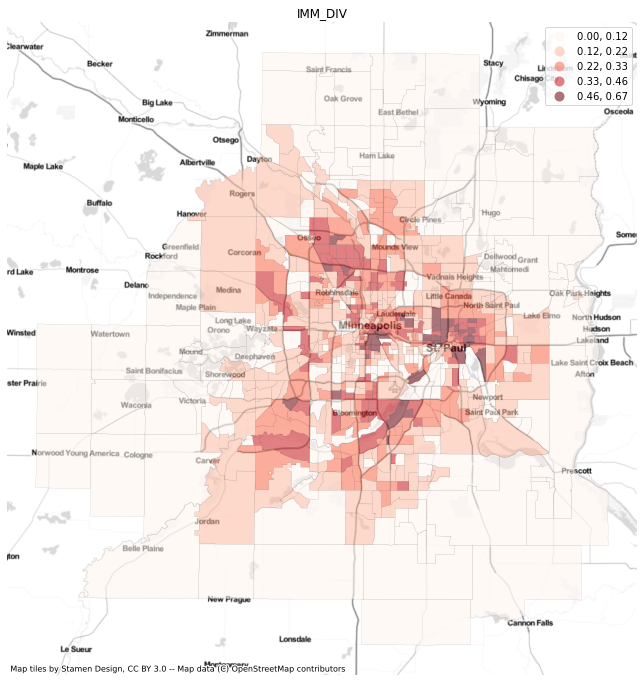

In [18]:
# Choropleth Map - Higher age diversity in the center of the Minneapolis, however less so in St Paul.
choro(tc_gdf, 'IMM_DIV')

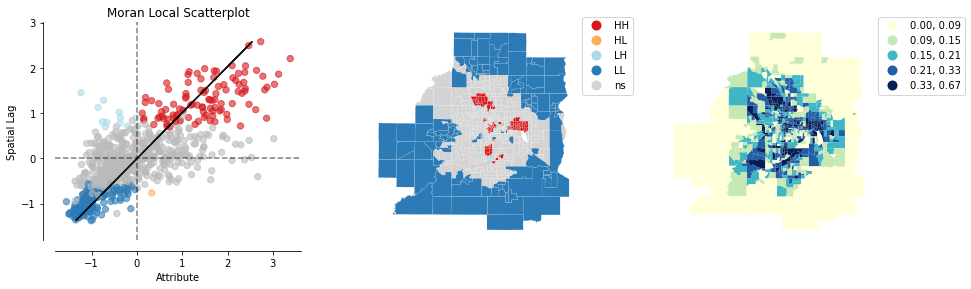

In [19]:
#Local Autocorrelation
local_autocorrelation(tc_gdf, 'IMM_DIV')

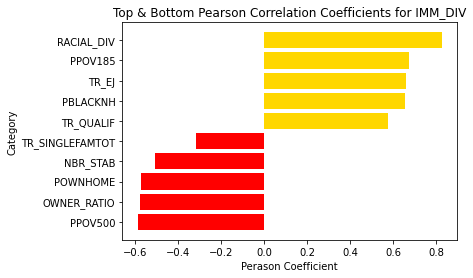

In [20]:
corr_pairs(tc_gdf, 'IMM_DIV')

Analysis: There are strong clusters of immigrant neighborhoods in the Northwest suburbs of Minneapolis (higher ratios of people of color in general), the neighborhoods surrounding Cedar Riverside, north Saint Paul, and Burnsville. These clusters  overlap with where low wage service sector workers live. Then, on the urban periphery, clusters with largely native born people with few immigrants. Strong positive correlations with racial diversity, poverty, environmental justice cocnerns, negative with waelth, owner ratio, percent who own homes, and single family total tracts. Makes sense - more likely to be renters and live in tracts with multi-family housing. Lower access to good blue-collar and high wage job markets.

#### Racial Diversity

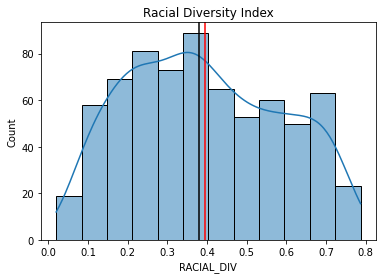

In [21]:
# Distribution: Relatively normal, with no strong tails
sns.histplot(x=tc_gdf['RACIAL_DIV'], kde=True)
plt.title('Racial Diversity Index')
plt.axvline(tc_gdf['RACIAL_DIV'].mean(), color = 'red')
plt.axvline(tc_gdf['RACIAL_DIV'].median(), color = 'k')

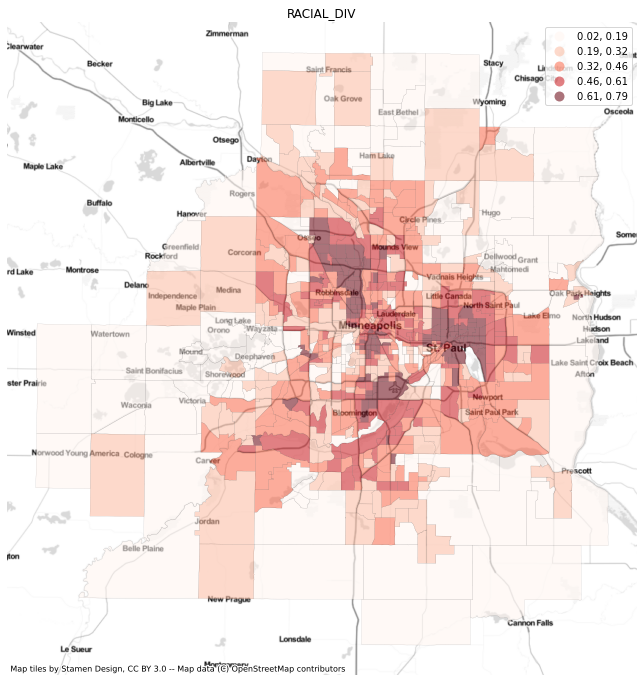

In [22]:
# Choropleth Map - Higher age diversity in the center of the Minneapolis, however less so in St Paul.
choro(tc_gdf, 'RACIAL_DIV')

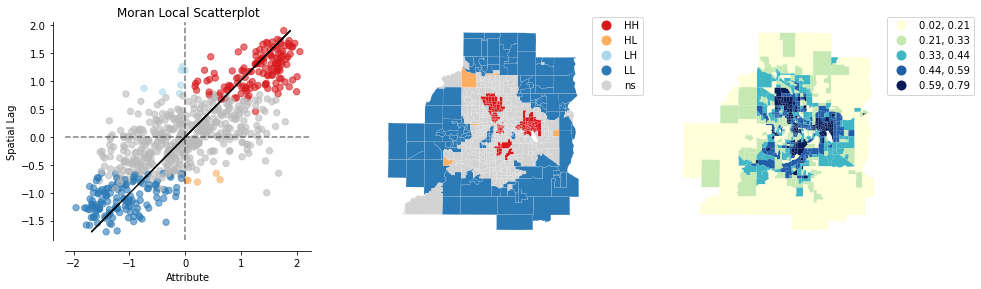

In [23]:
#Local Autocorrelation
local_autocorrelation(tc_gdf, 'RACIAL_DIV')

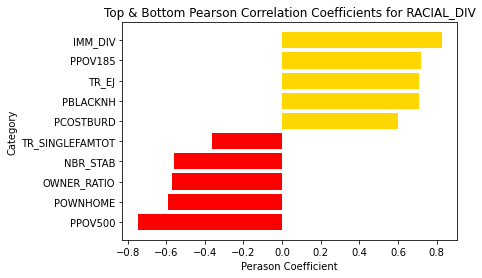

In [24]:
corr_pairs(tc_gdf, 'RACIAL_DIV')

Similar distribution to immigrant neighborhoods, however with a stronger emphasis on historically redlined neighborhoods south of Minneapolis that have higher concentrations of African Americans, and similarly in the 'wedge' pattern extending out of Northeast. Transitions quickly to the opposite on the speripher again, with low diversisty. The southeast wedge out of Minneapolis also remains largely white, and same with wealthier St Paul neighborhoods. Clustering is pretty stark. Also very likely that more diverse neighborhoods are more likely to be cost burdened, and also not very likely to own their own home or live in wealthy neighborhoods or work in high wage new economy jobs.

#### Percent Black
PBLACKNH

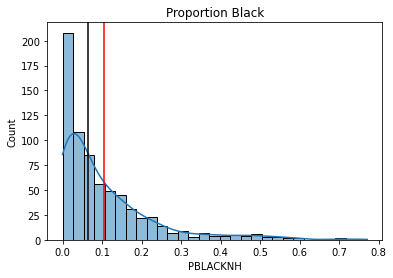

In [25]:
# Long skew right, with many blocks with very low % black, and a handful of tracts majority minority
sns.histplot(x=tc_gdf['PBLACKNH'], kde=True)
plt.title('Proportion Black')
plt.axvline(tc_gdf['PBLACKNH'].mean(), color = 'red')
plt.axvline(tc_gdf['PBLACKNH'].median(), color = 'k')

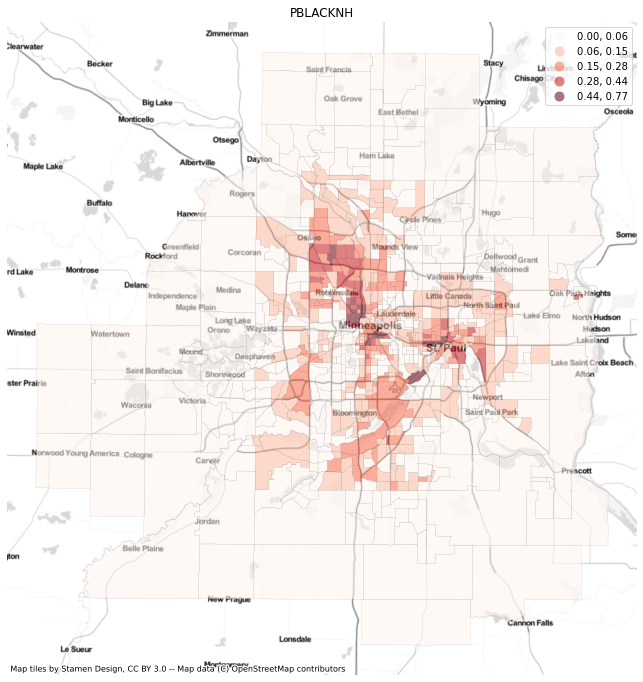

In [26]:
# Choropleth - Concentrated in North Minneapolis extending wedge like northeast, 
# in western St Paul, South Minneapolis and near Bloomington
choro(tc_gdf, 'PBLACKNH')

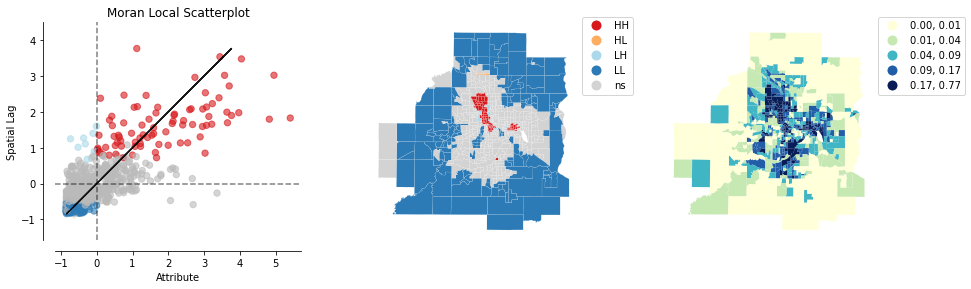

In [27]:
# Very clear cluster activity, both HH and LL, and it does look different than the racial diversity index
local_autocorrelation(tc_gdf, 'PBLACKNH')

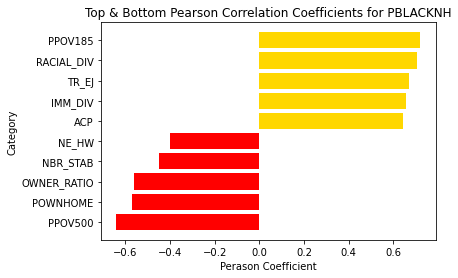

In [28]:
corr_pairs(tc_gdf, 'PBLACKNH')

There are clear clusters occuring in the percent black, with the far right skew demonstrating a far from even distribution, and strong HH and LL clusters indicating clear spatial patterns of segregation.

## Economic Indicators

- `PPOV185`	People whose family income is less than 185% of the federal poverty threshold, as a proportion of all people for whom poverty status is determined
- `PPOV500`	% of people whose income is at least 500% of the federal poverty threshold
- `INCOME_DIV` - An income diversity index to capture the income diversity of a neighborhood
- `INC_CHG` - Measures percent change in household income
- `OE_BC` - Measures residential density of people who work in 'Old Economy Blue Collar' Occupations
- `NE_LW` - Measures residential density of people who work in 'New Economy Low Wage' Occupations
- `NE_MW` - Measures residential density of people who work in 'New Economy Medium Wage' Occupations
- `NE_HW` - Measures residential density of people who work in 'New Economy High Wage' Occupations

#### Percent less than 185% of federal poverty threshold


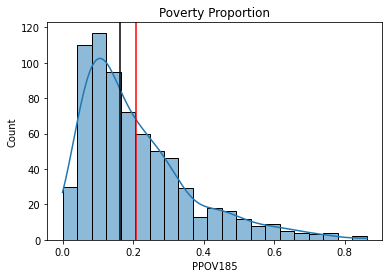

In [29]:
# Right skewed, again showing some levels of concentrated poverty in an otherwise pretty well off city
sns.histplot(x=tc_gdf['PPOV185'], kde=True)
plt.title('Poverty Proportion')
plt.axvline(tc_gdf['PPOV185'].mean(), color = 'red')
plt.axvline(tc_gdf['PPOV185'].median(), color = 'k')

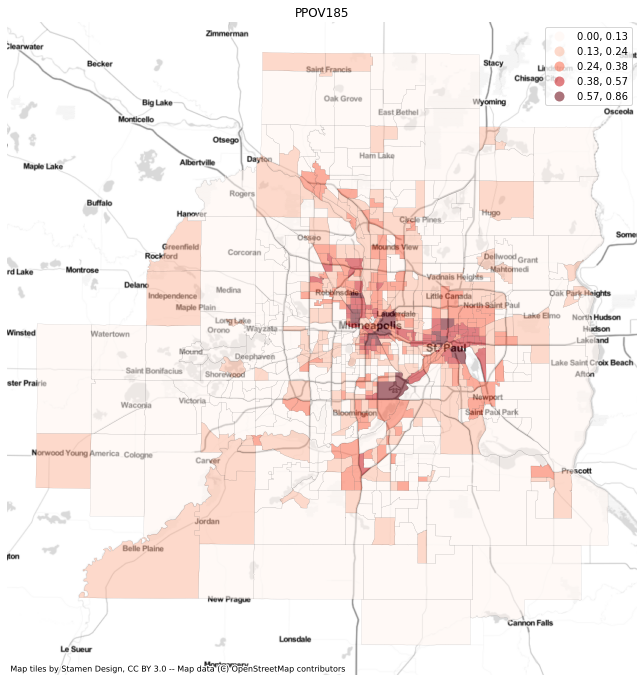

In [30]:
# Areas of concentrated poverty closely align with race - should check for collinearity
choro(tc_gdf, 'PPOV185')

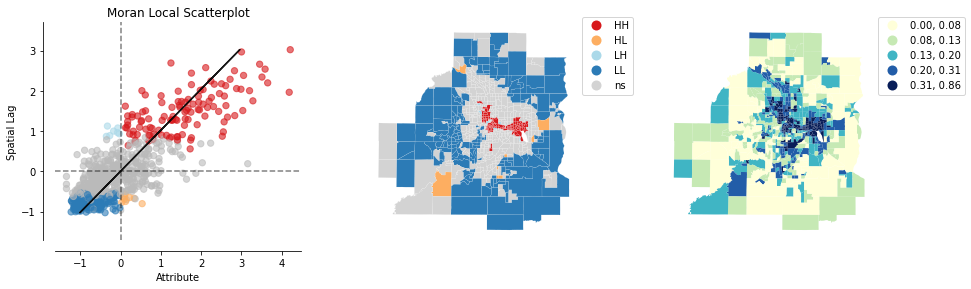

In [31]:
# Strong clustering behavior with lower income tracts, however it is interesting that the first ring suburbs have more mixed
# incomes, with only the outer suburbs showing LL clusters. Also interesting is higher poverty levels in Shakopee/Scott County
local_autocorrelation(tc_gdf, 'PPOV185')

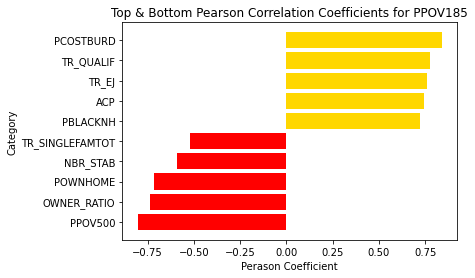

In [32]:
corr_pairs(tc_gdf, 'PPOV185')

Strong clustering behavior with lower income tracts, however it is interesting that the first ring suburbs have more mixed incomes, with only the outer suburbs showing LL clusters. Also interesting is higher poverty levels in Shakopee/Scott County.

#### Areas of Concentrated Poverty (binary)

In [33]:
tc_gdf['ACP'].value_counts()


0.0    620
1.0     83
Name: ACP, dtype: int64

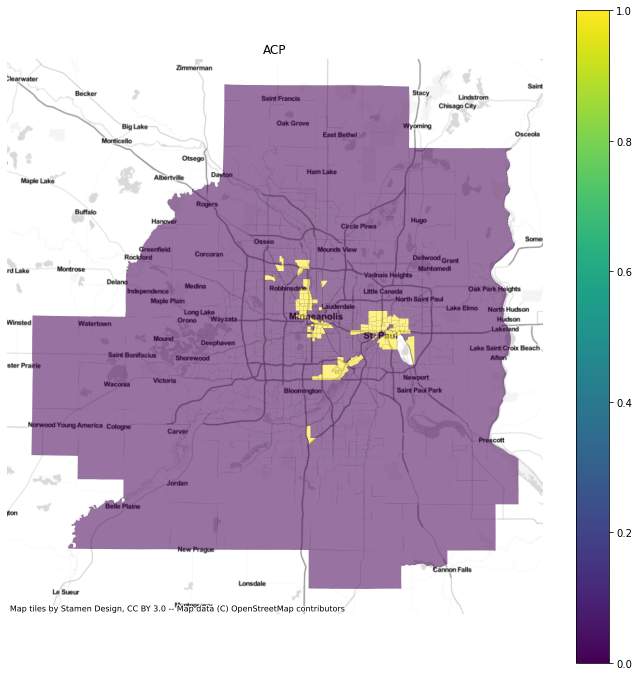

In [34]:
# Category Map
cat_map(tc_gdf, 'ACP')

C:\Users\scox0\anaconda3\envs\geo_env\lib\site-packages\mapclassify\classifiers.py:238: UserWarning: Warning: Not enough unique values in array to form k classes
  Warn(
C:\Users\scox0\anaconda3\envs\geo_env\lib\site-packages\mapclassify\classifiers.py:241: UserWarning: Warning: setting k to 2
  Warn("Warning: setting k to %d" % k_q, UserWarning)


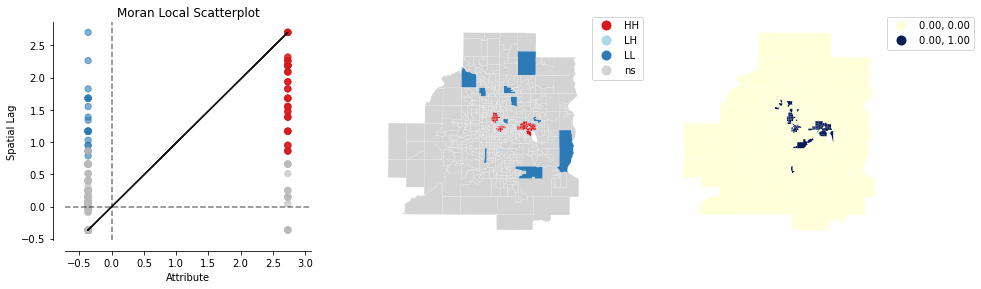

In [35]:
#autocorrelation for binary
local_autocorrelation(tc_gdf, 'ACP')

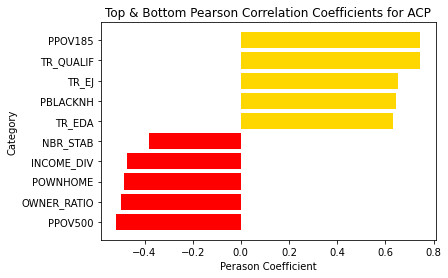

In [36]:
corr_pairs(tc_gdf, 'ACP')

Not sure the information here is super useful, however the areas of very high concentrations of poverty are in south and north Minneapolis and west/central St Paul. There will probably be strong multi-collinearity/correlation between Areas of Concentrated Poverty and other economic indicators.

#### Wealthy Neighborhoods
- `PPOV500`	% of people whose income is at least 500% of the federal poverty threshold

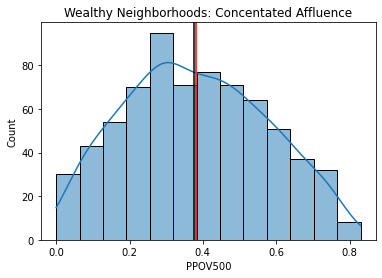

In [37]:
# Distribution wide and slightly right, indicates a few neighborhoods with a lot of wealth, a decent middle, but less rich
sns.histplot(x=tc_gdf['PPOV500'], kde=True)
plt.title('Wealthy Neighborhoods: Concentated Affluence')
plt.axvline(tc_gdf['PPOV500'].mean(), color = 'red')
plt.axvline(tc_gdf['PPOV500'].median(), color = 'k')

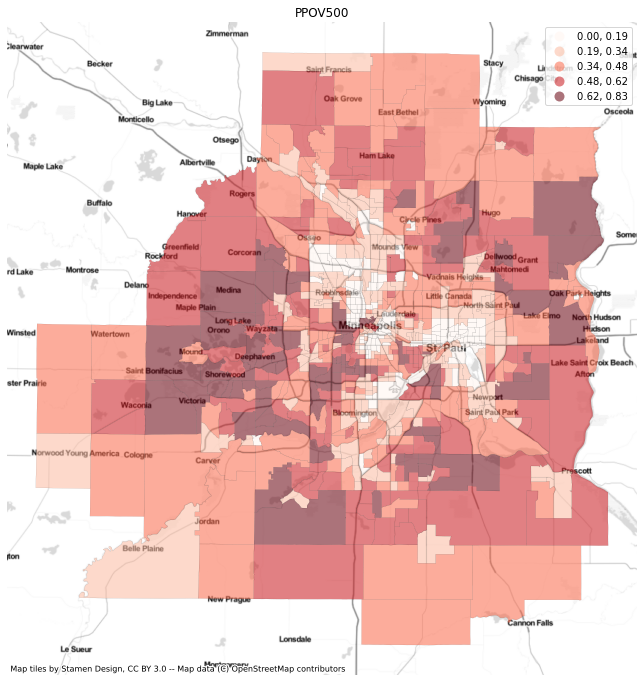

In [38]:
choro(tc_gdf, 'PPOV500')

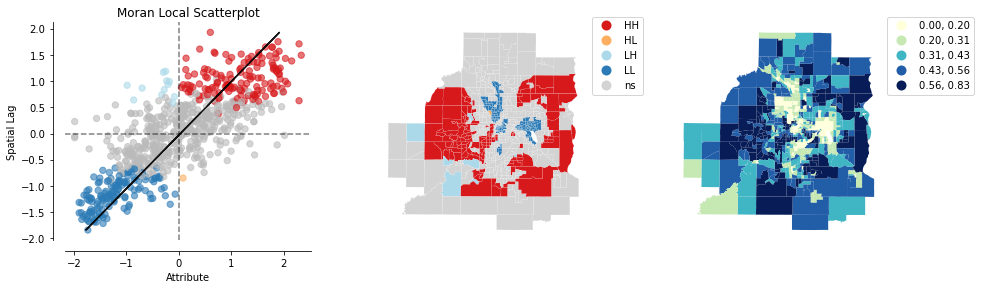

In [39]:
local_autocorrelation(tc_gdf, 'PPOV500')

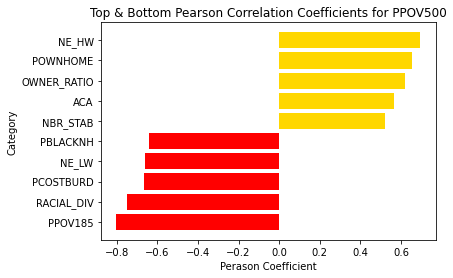

In [40]:
corr_pairs(tc_gdf, 'PPOV500')

Again, clear wealth clustering patterns, with LL patterns in areas with higher concentrated poverty, and HH patterns in wealth sububrs to the west of MInneapolis, East of St Paul, and second ring suburbs to the south. High correlation with home ownership, and high wage new economy jobs, very white.

#### Income Diversity Index
Shows more mixed income neighborhoods rather than neighborhoods with higher concentration of wealth and/or poverty.


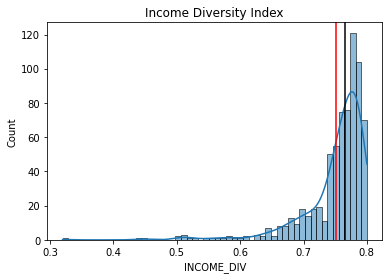

In [41]:
# Strong left skew shows a handful of neighborhoods with very low income diversity, but the majority tend towards similar
# diversity levels
sns.histplot(x=tc_gdf['INCOME_DIV'], kde=True)
plt.title('Income Diversity Index')
plt.axvline(tc_gdf['INCOME_DIV'].mean(), color = 'red')
plt.axvline(tc_gdf['INCOME_DIV'].median(), color = 'k')

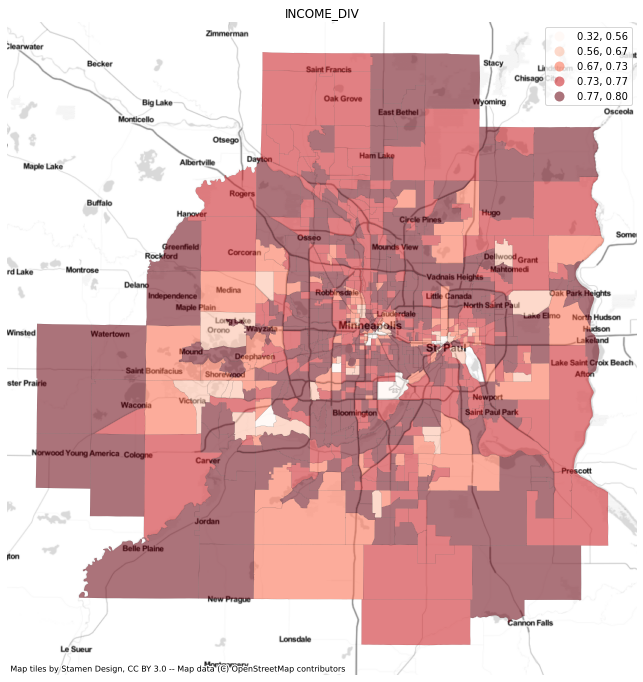

In [42]:
choro(tc_gdf, 'INCOME_DIV')

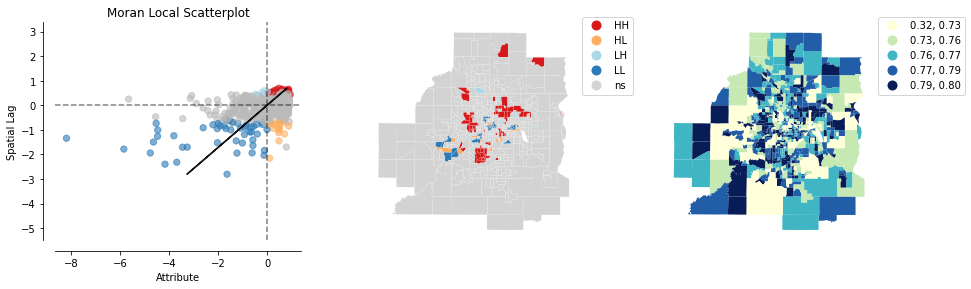

In [43]:
local_autocorrelation(tc_gdf, 'INCOME_DIV')

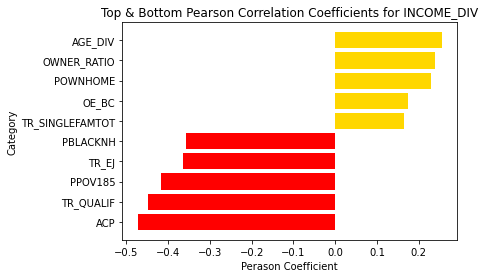

In [44]:
corr_pairs(tc_gdf, 'INCOME_DIV')

Interesting, the cluster activity is not excellent on the HH side, with some of the first ring suburbs showing higher levels of income diversity, with LL income diversity in both the areas of highly concentrated wealth and highly concentrated poverty. Also more diverse incomes are correlated with age diversity, and, of note, old economy blue collar jobs (higher rate of unionization in the trades/manufacturing).

#### Percent Household Income Change
INC_CHG

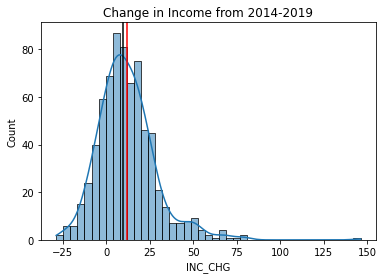

In [45]:
# Interesting right skew, most neighborhoods have some seen some increase in wealth, tracking with wage increases,
# however some neighborhoods have seen rates that far outpace wage growth, more than doubling! average income.
# Pretty hardcore gentrification
sns.histplot(x=tc_gdf['INC_CHG'], kde=True)
plt.title('Change in Income from 2014-2019')
plt.axvline(tc_gdf['INC_CHG'].mean(), color = 'red')
plt.axvline(tc_gdf['INC_CHG'].median(), color = 'k')

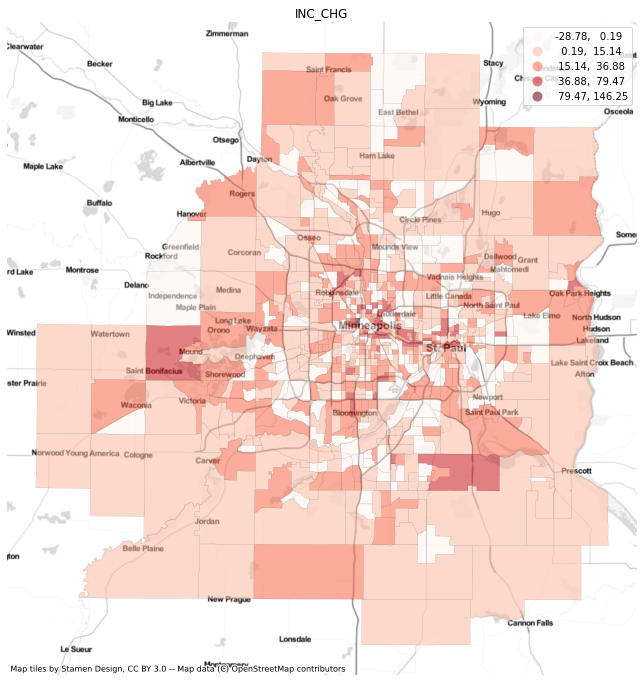

In [46]:
choro(tc_gdf, 'INC_CHG')

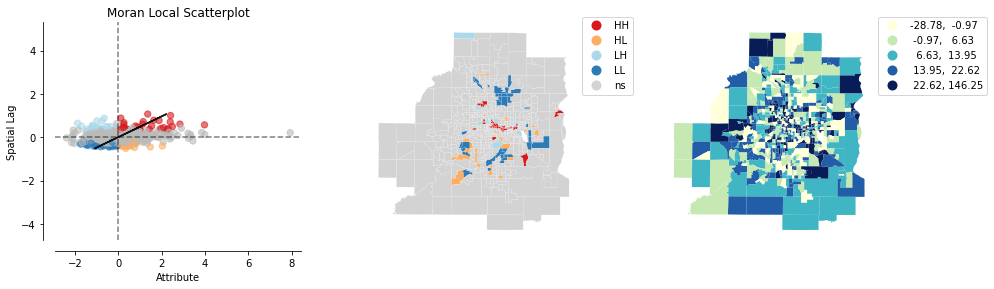

In [47]:
local_autocorrelation(tc_gdf, 'INC_CHG')

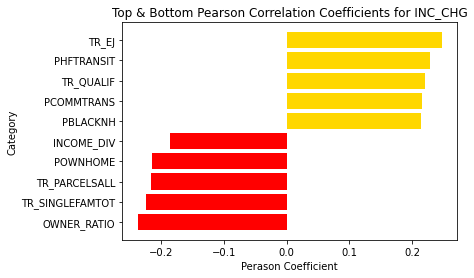

In [48]:
corr_pairs(tc_gdf, 'INC_CHG')

Interesting observations here that are tough to decipher on first glance. Some of the first ring suburbs have gotten poorer, with stronger auto-correlation, reinforcing the suburbanization of poverty hypothesis. Interesting too that there are higher proportions of LH, or tracts with low values (lower HH income) bordering those with Higher income. HL areas are in the borders between gentrifying neighborhoods and neighborhoods of concentrated poverty (did not gentrify).  Greatest increases are largely concentrated in the city in gentrifying neighborhoods. Some urban inversion (higher income moving into the city, displacing lower income people into the suburban periphery. Also the correlation with transit is interesting - corresponds with increased mixed-use transit oriented development at market rates along the two major light rail lines. Lower homeownersip is indicative.

#### Old Economy Blue Collar Occupations (Resident Area)
OEBC

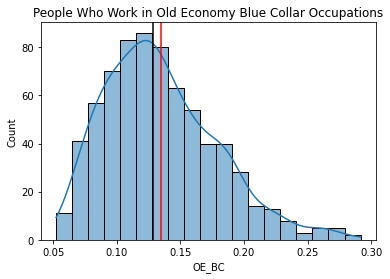

In [49]:
# Some neighborhoods with higher concentration leads to right skew
sns.histplot(x=tc_gdf['OE_BC'], kde=True)
plt.title('People Who Work in Old Economy Blue Collar Occupations')
plt.axvline(tc_gdf['OE_BC'].mean(), color = 'red')
plt.axvline(tc_gdf['OE_BC'].median(), color = 'k')

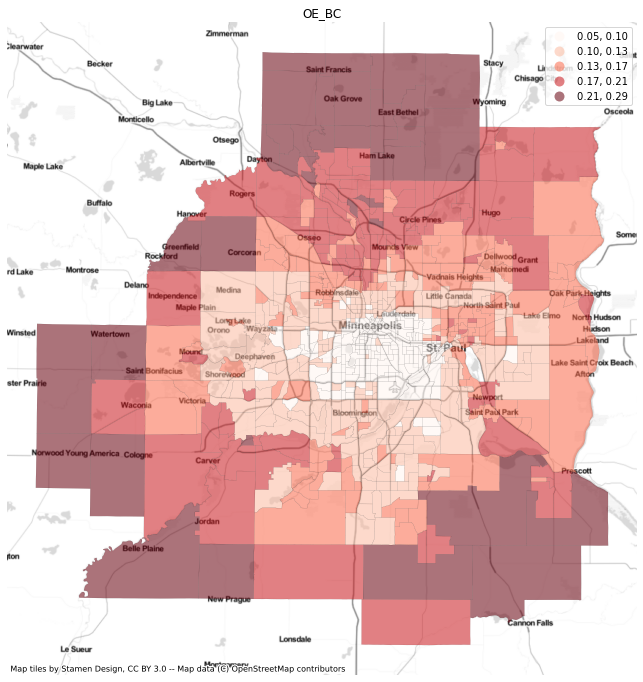

In [50]:
choro(tc_gdf, 'OE_BC')

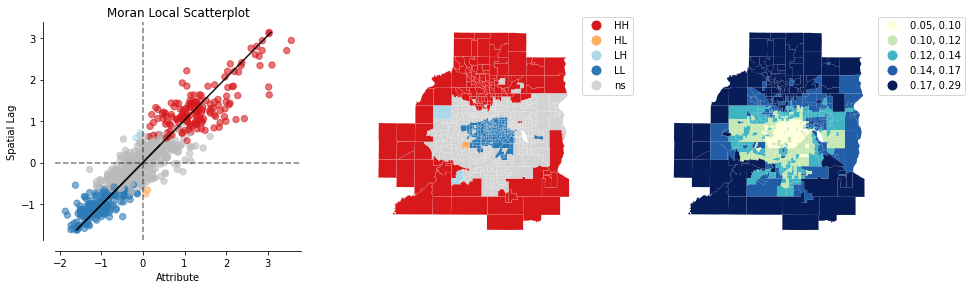

In [51]:
local_autocorrelation(tc_gdf, 'OE_BC')

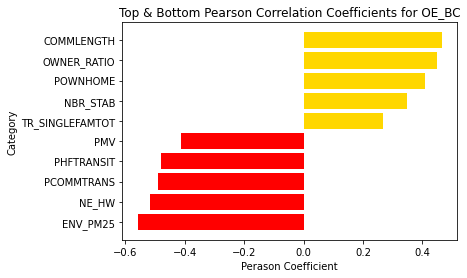

In [52]:
corr_pairs(tc_gdf, 'OE_BC')

Really strong clustering behavior based on occupation, with blue collar workers highly concentrated in the suburban periphery, and largely lacking from the urban core, also highly correlated with race (white). This is the class layer that first moved to suburban areas in the post-war area, and as lower wage service sector workers displace from the city center out, have sold houses and moved deeper into second ring suburbs. Also lots of driving! Interesting that the the second largest negative correlation is people who work in blue collar jobs with people who work in high wage new economy occupations.

## New Economy Low Wage
NE_LW

Text(0.5, 1.0, 'New Economy Low Wage')

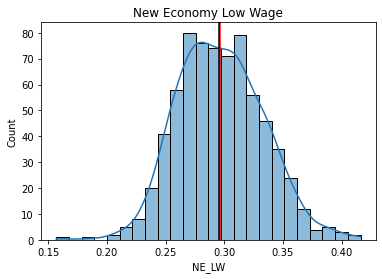

In [53]:
# Relatively normal distribution around the median and mean, with some left skew (neighborhoods without lower wage workers)
sns.histplot(x=tc_gdf['NE_LW'], kde=True)
plt.axvline(tc_gdf['NE_LW'].mean(), color = 'red')
plt.axvline(tc_gdf['NE_LW'].median(), color = 'k')
plt.title('New Economy Low Wage')


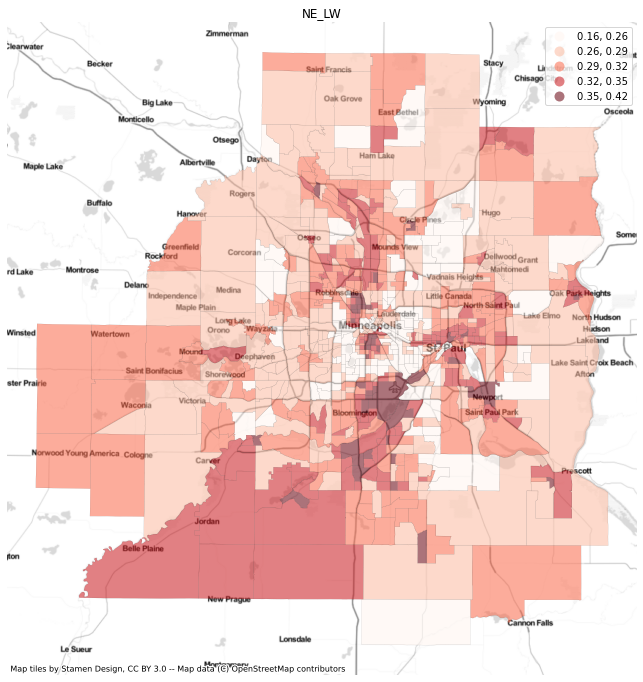

In [54]:
choro(tc_gdf, 'NE_LW')

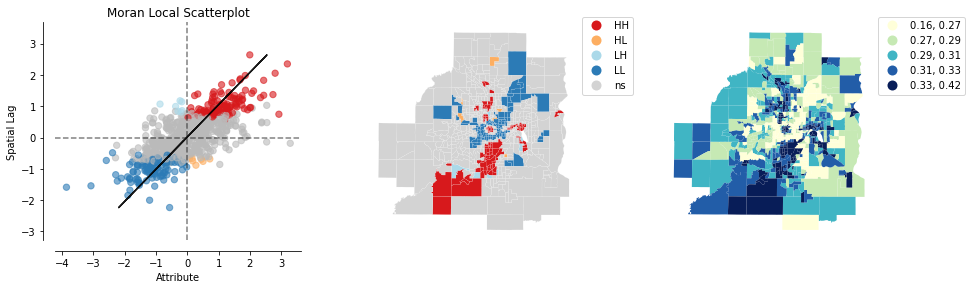

In [55]:
local_autocorrelation(tc_gdf, 'NE_LW')

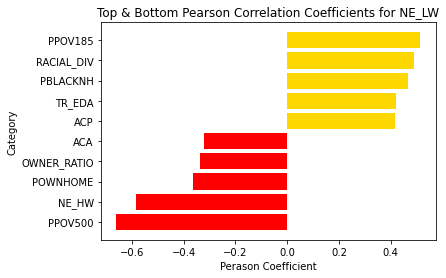

In [56]:
corr_pairs(tc_gdf, 'NE_LW')

Cluster maps add clarity to neighborhoods with HH (neighborhoods around the urban core in St Paul and Minneapolis, and then stronger percentages in the southern suburbs of burnsville and into Scott County. Interesting that the LL areas are in urban residential neighborhoods. Strong negative correlation with NE_HW is again interesting, speaking to class and racial stratification and spatial unevenness.

#### NE_MW

Text(0.5, 1.0, 'New Economy Middle Wage Occupations')

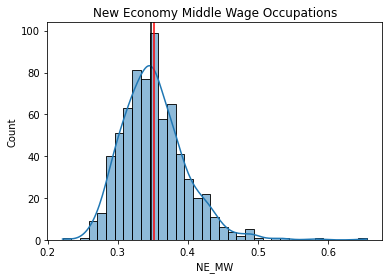

In [57]:
# Right skew showing some higher concentrated neighborhoods
sns.histplot(x=tc_gdf['NE_MW'], kde=True)
plt.axvline(tc_gdf['NE_MW'].mean(), color = 'red')
plt.axvline(tc_gdf['NE_MW'].median(), color = 'k')
plt.title('New Economy Middle Wage Occupations')


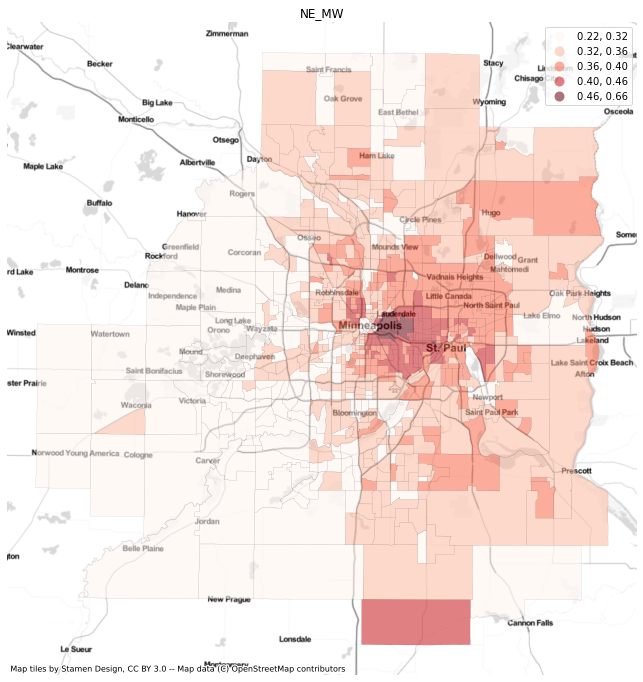

In [58]:
choro(tc_gdf, 'NE_MW')

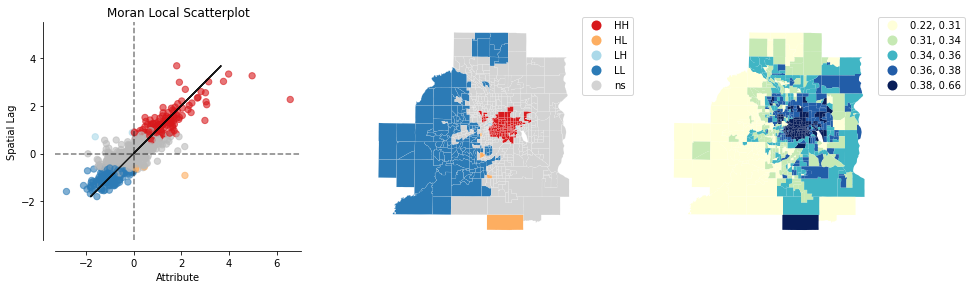

In [59]:
local_autocorrelation(tc_gdf, 'NE_MW')

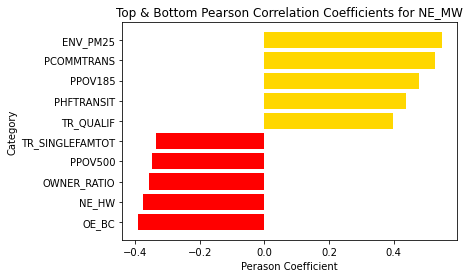

In [60]:
corr_pairs(tc_gdf, 'NE_MW')

Interesting again! HH clusters are very strong for college-educated mid-wage jobs in the urban core, whereas the population is significantly less in the western wealthy sububrs and blue collar neighborhoods in the north. Really strong clustering in urban residential neighborhoods (two sides of the democratic party). The grey areas also seem to more closely overlap with low wage service sector workers than either wealthier or blue collar. Also interesting that its just strongly correlated with transit-oriented development.

#### New Economy High Wage

Text(0.5, 1.0, 'New Economy High Wage')

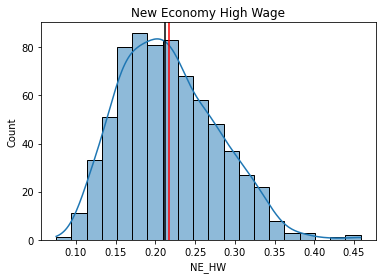

In [61]:
# Stronger right skew showing higher levels of concentration in a smaller handful of tracts
sns.histplot(x=tc_gdf['NE_HW'], kde=True)
plt.axvline(tc_gdf['NE_HW'].mean(), color = 'red')
plt.axvline(tc_gdf['NE_HW'].median(), color = 'k')
plt.title('New Economy High Wage')


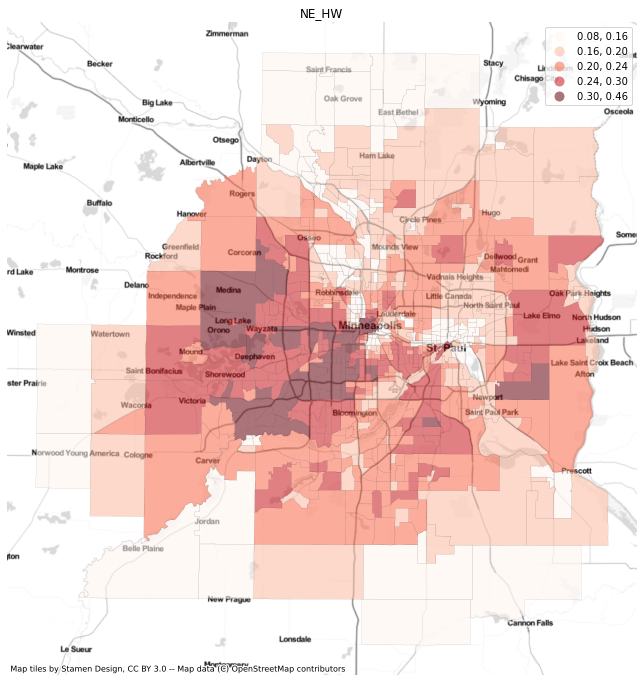

In [62]:
choro(tc_gdf, 'NE_HW')

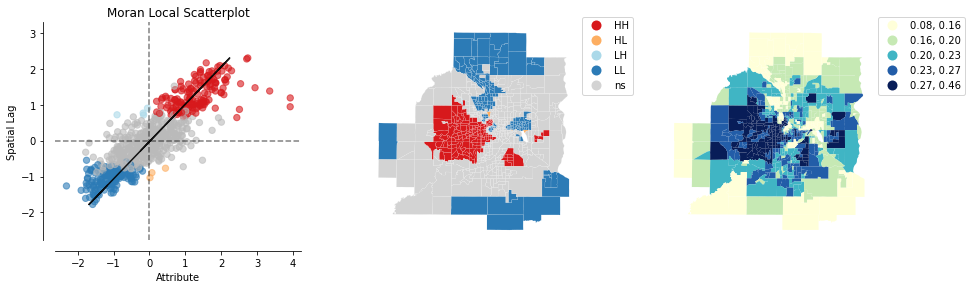

In [63]:
local_autocorrelation(tc_gdf, 'NE_HW')

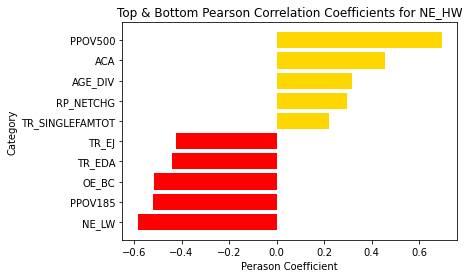

In [64]:
corr_pairs(tc_gdf, 'NE_HW')

The clustering activity here shows strong HH correlation in the western suburbs of Minneapolism parts of south St Paul and east St Paul. Interesing that LL neighborhooods are both low wage new economy and blue collar. Not surprising that there is more mingling with the college educated mid-wage New Economy workers. Interestingly, it is in areas where NE_HW workers move that have seen higher rent hikes (as people move into new neighborhoods).

## Commuting Indicators
Commute Indicators
- `PHFTRANSIT`	Proportion of residents living within one-half mile of high-frequency transit
- `COMMLENGTH`	Mean commute length (in minutes)
- `PCOMMTRANS`	Proportion of commuters who took public transportation to work
- `PJOB_LT5`	Proportion of jobs held by workers who live less than 5 miles away (primary jobs only; excludes second or third jobs)

#### PHFTRANSIT - Proportion of residents living within one half mile of high frequency transit

Text(0.5, 1.0, 'High Speed Transit Access')

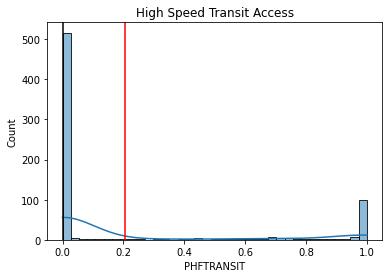

In [65]:
# Almost binary distribution between no connection to high speed transit, or a much smaller distibution with public
#transit connection
sns.histplot(x=tc_gdf['PHFTRANSIT'], kde=True)
plt.axvline(tc_gdf['PHFTRANSIT'].mean(), color = 'red')
plt.axvline(tc_gdf['PHFTRANSIT'].median(), color = 'k')
plt.title('High Speed Transit Access')


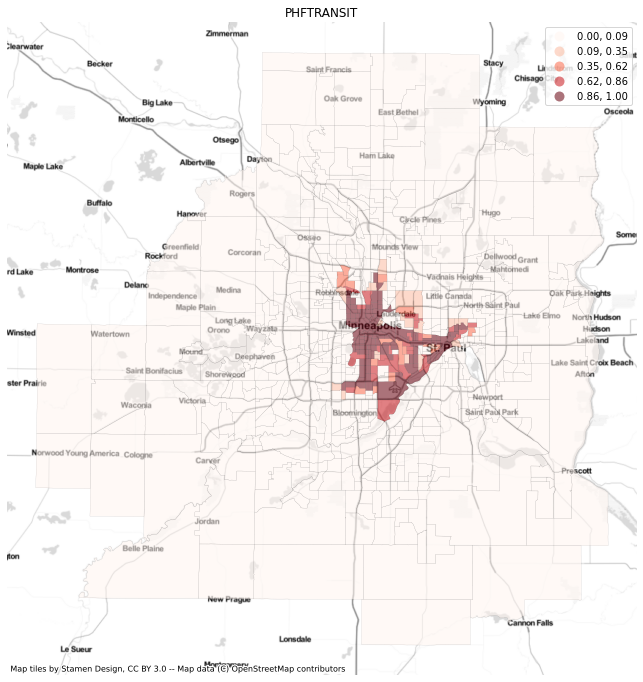

In [66]:
choro(tc_gdf, 'PHFTRANSIT')

C:\Users\scox0\anaconda3\envs\geo_env\lib\site-packages\mapclassify\classifiers.py:238: UserWarning: Warning: Not enough unique values in array to form k classes
  Warn(
C:\Users\scox0\anaconda3\envs\geo_env\lib\site-packages\mapclassify\classifiers.py:241: UserWarning: Warning: setting k to 3
  Warn("Warning: setting k to %d" % k_q, UserWarning)


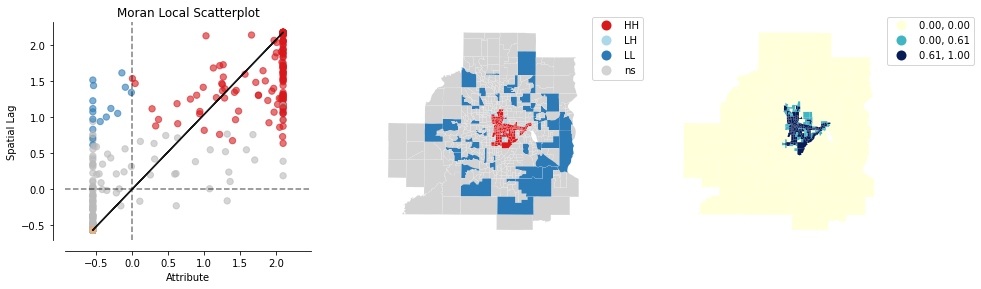

In [67]:
local_autocorrelation(tc_gdf, 'PHFTRANSIT')

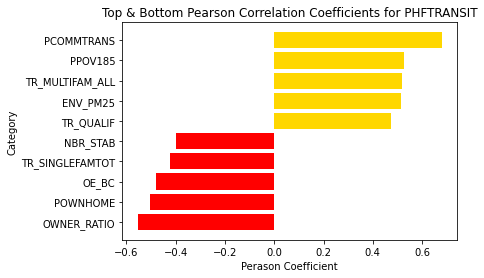

In [68]:
corr_pairs(tc_gdf, 'PHFTRANSIT')

Closely follows N/S bus lines running through Minneapolis and St Paul, and the light rail lines, with the suburbs largely lacking any high speed rail. Urban coverage is pretty strong, except for wealthier western suburbs (which is a bit surprising, as the highest ratio of professional workers who work in downtown live west of the city.

#### Commute Length 
COMMLENGTH

Text(0.5, 1.0, 'Commute Length')

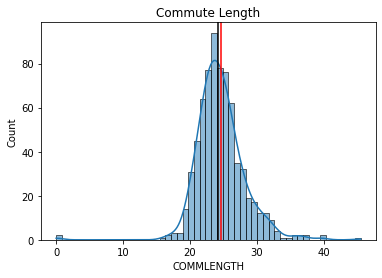

In [69]:
# Pretty normal distribution with average commute settling around 25 minutes
sns.histplot(x=tc_gdf['COMMLENGTH'], kde=True)
plt.axvline(tc_gdf['COMMLENGTH'].mean(), color = 'red')
plt.axvline(tc_gdf['COMMLENGTH'].median(), color = 'k')
plt.title('Commute Length')


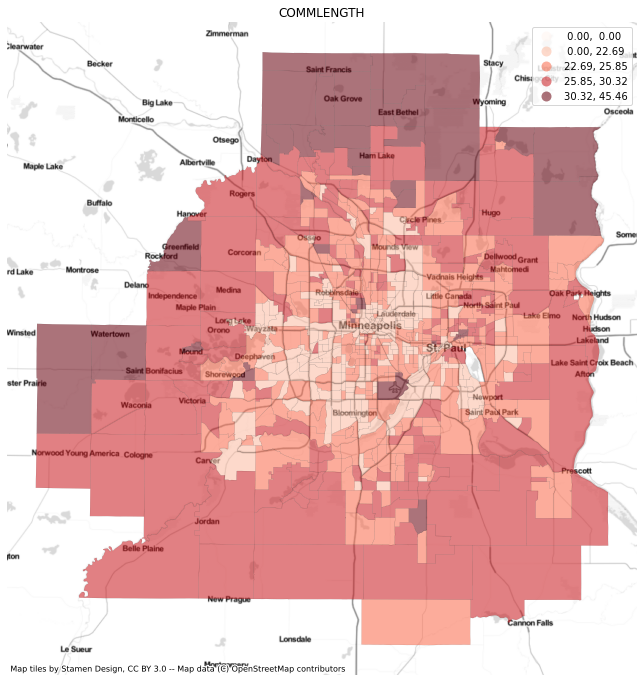

In [70]:
choro(tc_gdf, 'COMMLENGTH')

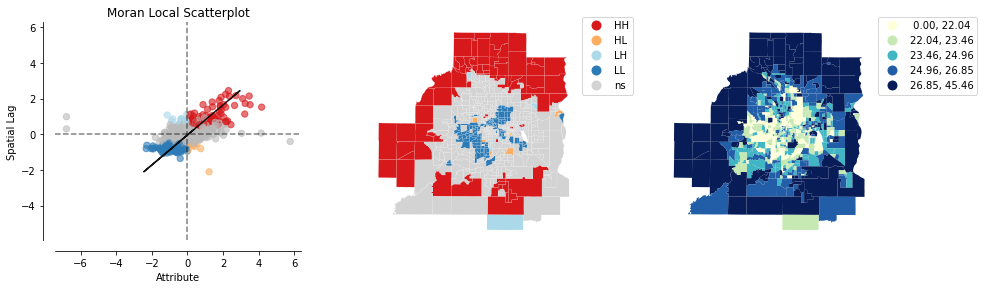

In [71]:
local_autocorrelation(tc_gdf, 'COMMLENGTH')

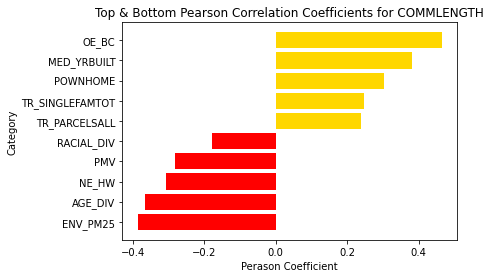

In [72]:
corr_pairs(tc_gdf, 'COMMLENGTH')

Some interesting tidbits, further out locations have longer commutes. Blue collar workers then not only live in the exurbs, but largely work outside where they live, leading to higher levels of commute times - and greater auto/oil dependency. Also, interesting to see that new homes correspond to higher commutes (new suburban developments)

#### Public Transit Use
PCOMMTRANS

Text(0.5, 1.0, 'Proportion Who Frequently Use Transit')

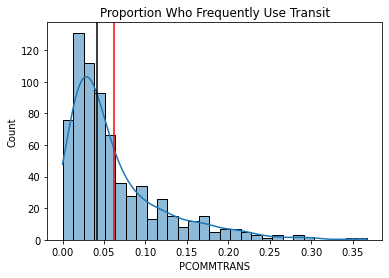

In [73]:
# Strong right skew, with most tracts having very few people who depend on transit, and a fewer tracts with much higher concetrations
sns.histplot(x=tc_gdf['PCOMMTRANS'], kde=True)
plt.axvline(tc_gdf['PCOMMTRANS'].mean(), color = 'red')
plt.axvline(tc_gdf['PCOMMTRANS'].median(), color = 'k')
plt.title('Proportion Who Frequently Use Transit')


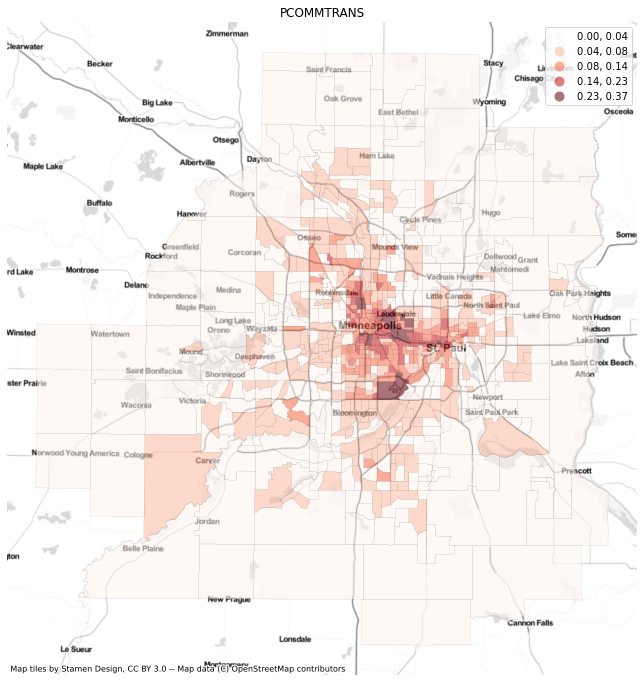

In [74]:
choro(tc_gdf, 'PCOMMTRANS')

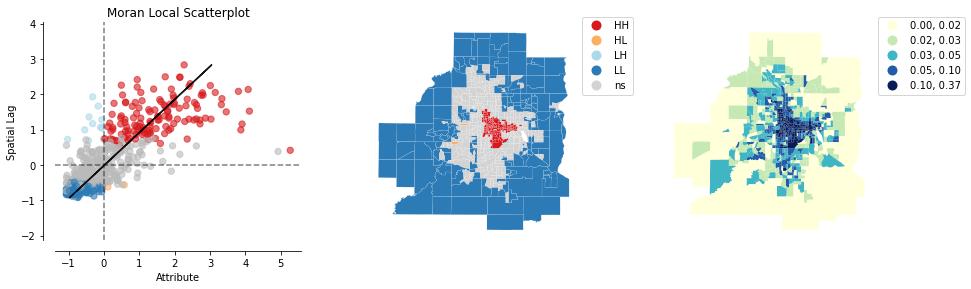

In [75]:
local_autocorrelation(tc_gdf, 'PCOMMTRANS')

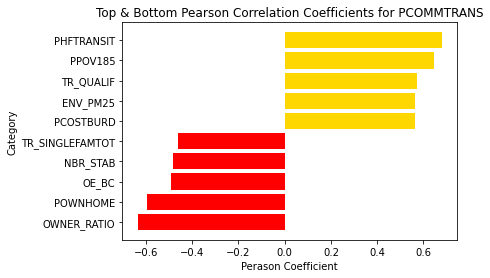

In [76]:
corr_pairs(tc_gdf, 'PCOMMTRANS')

Pretty strong correlation with highspeed tranist options, but also explicity with light rail networks that are radial to downtown and midwage New Economy workers. Less oriented around low wage service sector workers in first ring suburbs.

#### Proximity to work
PJOB_LT5

Text(0.5, 1.0, 'Proportion in Tract Living 5 Minutes From Work')

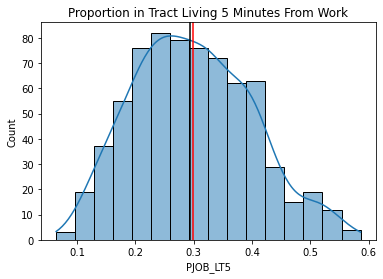

In [77]:
#More normal that I would expect, with the proportion of people living about 5 minutes from work hovering around 30%
sns.histplot(x=tc_gdf['PJOB_LT5'], kde=True)
plt.axvline(tc_gdf['PJOB_LT5'].mean(), color = 'red')
plt.axvline(tc_gdf['PJOB_LT5'].median(), color = 'k')
plt.title('Proportion in Tract Living 5 Minutes From Work')


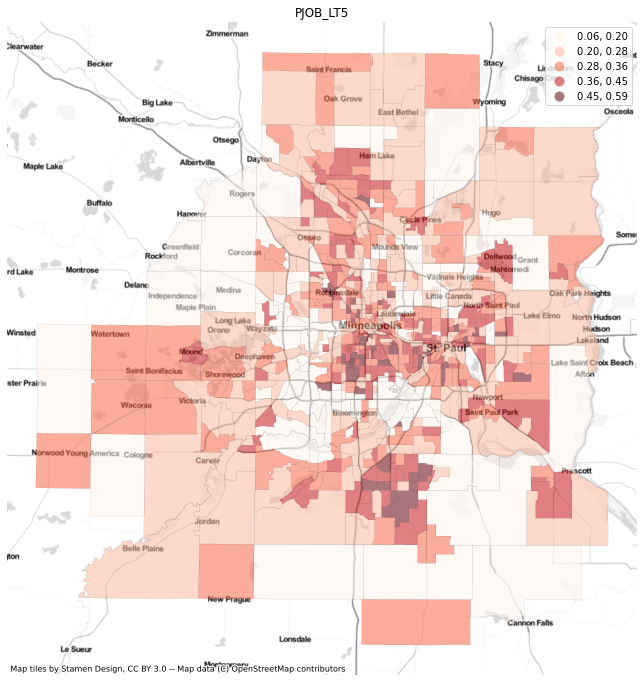

In [78]:
choro(tc_gdf, 'PJOB_LT5')

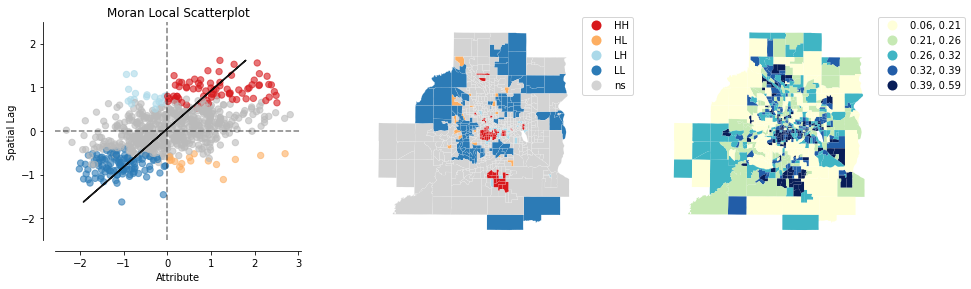

In [79]:
local_autocorrelation(tc_gdf, 'PJOB_LT5')

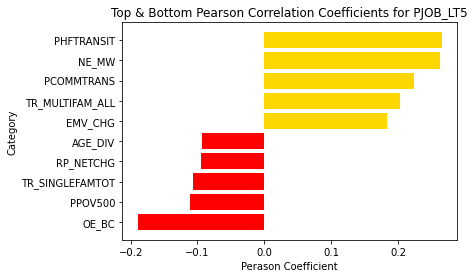

In [80]:
corr_pairs(tc_gdf, 'PJOB_LT5')

Interesting clusters here, with residential Minneapolis neighborhoods and neighborhoods close to the airport showing close proximity to work. Seems many airport workers live near work! Interestingtly, wealthier western sububranites live further from work but don't have much access to high speed light rail.

## Environmental Indicators
Environmental Indicators
- `TR_EJ`	Area of Environmental Justice Concern (1 = yes; 0 = no)

#### TR_EJ

Areas of environmental concern are tightly mirroring poorer and more diverse areas

In [81]:
tc_gdf['TR_EJ'].value_counts()

0.0    534
1.0    169
Name: TR_EJ, dtype: int64

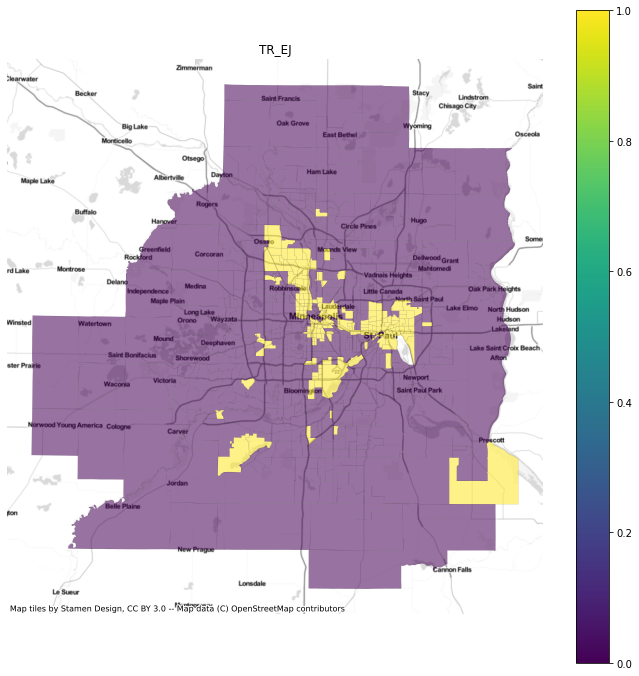

In [82]:
cat_map(tc_gdf, 'TR_EJ')

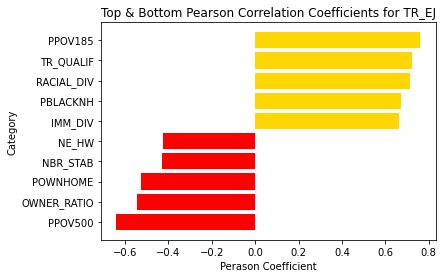

In [83]:
corr_pairs(tc_gdf, 'TR_EJ')

Environmental indicators seems to closely align with racialized income inequality.

## Housing Indicators
- `PMV`	Proportion who moved to current housing unit in the last year (out of residents age 1+)
- `MV_MDYR`	Median year households moved into homes
- `POWNHOME`	Homeownership rate
- `PCOSTBURD`	% housing cost-burdened (housing costs are 30%+ of household income)
- `RP_NETCHG`	Net change in number of housing units, 2010-2019
- `OWNER_RATIO` - Ratio of homeowners as proportion of total households
- `RENT_CHG` - Measures percent change rent
- `EMV_CHG` - Measures percent change in market value
- `AFF_CHG` - Measures percent change in deep affordability

### Proportion who moved into current housing in the last year
Neighborhood Churn

Text(0.5, 1.0, 'Proportion Moved Into Housing in the Last Year')

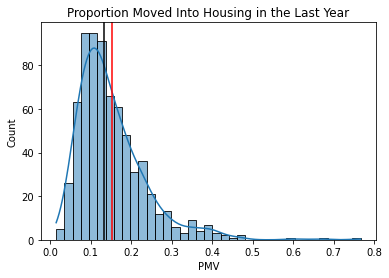

In [84]:
# Many neighborhoods are relative stable with about 13% neighborhood turnover per year, however some districts are extremely high.
sns.histplot(x=tc_gdf['PMV'], kde=True)
plt.axvline(tc_gdf['PMV'].mean(), color = 'red')
plt.axvline(tc_gdf['PMV'].median(), color = 'k')
plt.title('Proportion Moved Into Housing in the Last Year')


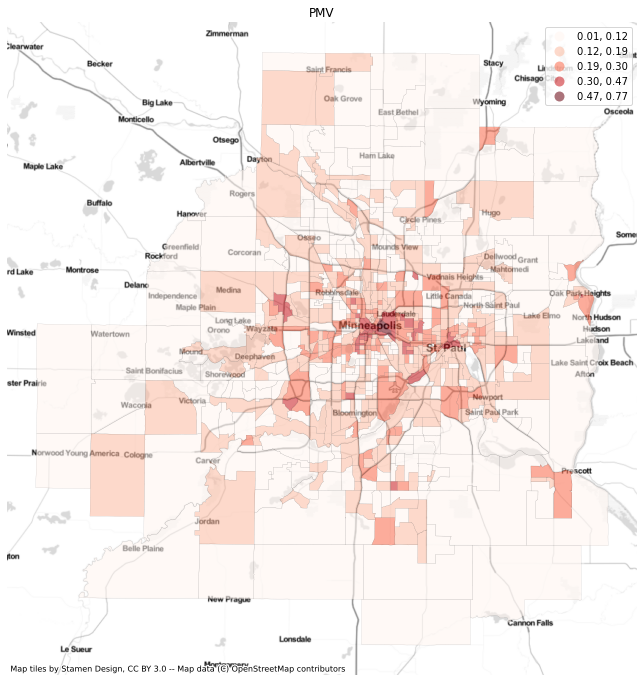

In [85]:
choro(tc_gdf, 'PMV')

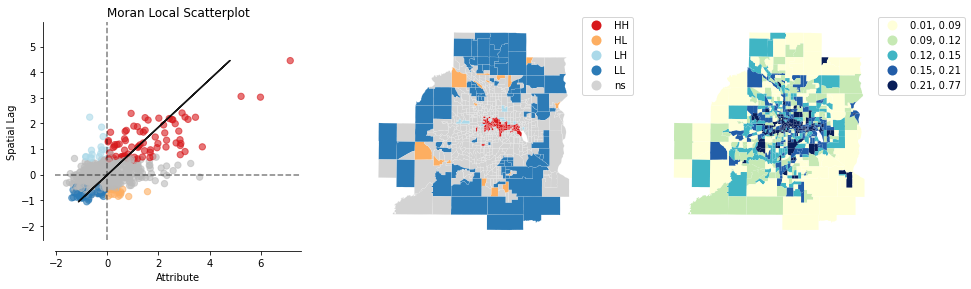

In [86]:
local_autocorrelation(tc_gdf, 'PMV')

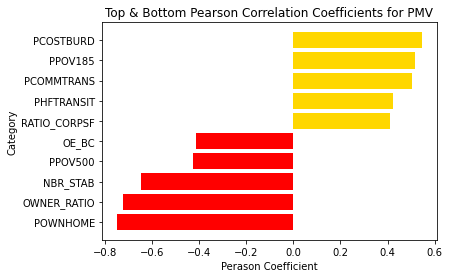

In [87]:
corr_pairs(tc_gdf, 'PMV')

While the strongest statistical clusters are in the urban core where new multi-family development is common, prices are rising, and people are moving in, there is an interesting ring in the first-ring suburbs of people who are moving *out* of the tracts in the center and *into* the suburbs. This also shows that those who are cost burdened, are poor, and more diverse are more likely to be moving (displaced). Also not surprising that neighborhoods with more home owners, and, interesting, OE_BC jobs, are stable.

#### Neighborhood Stability
Calculated by Median duration in home of the tract/mean duration in home of the region.

Text(0.5, 1.0, 'Neighborhood Stability')

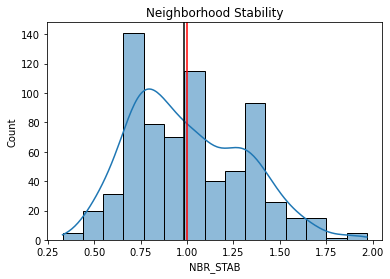

In [88]:
sns.histplot(x=tc_gdf['NBR_STAB'], kde=True)
plt.axvline(tc_gdf['NBR_STAB'].mean(), color = 'red')
plt.axvline(tc_gdf['NBR_STAB'].median(), color = 'k')
plt.title('Neighborhood Stability')


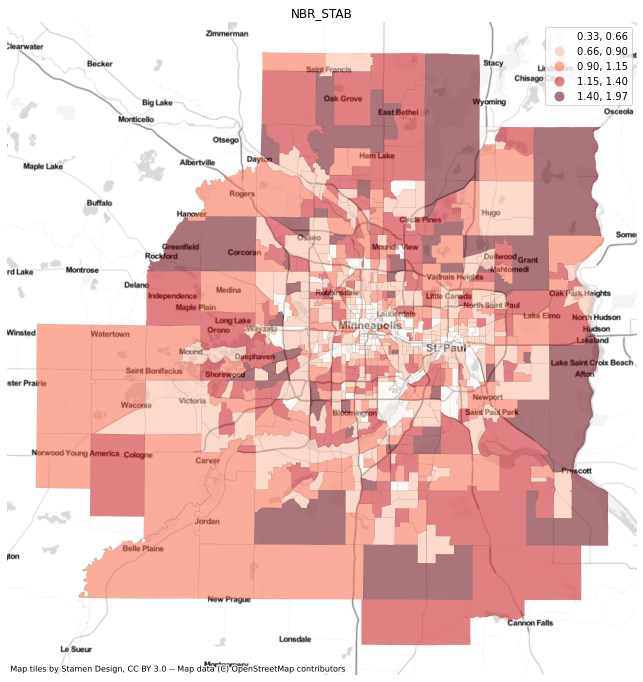

In [89]:
choro(tc_gdf, 'NBR_STAB')

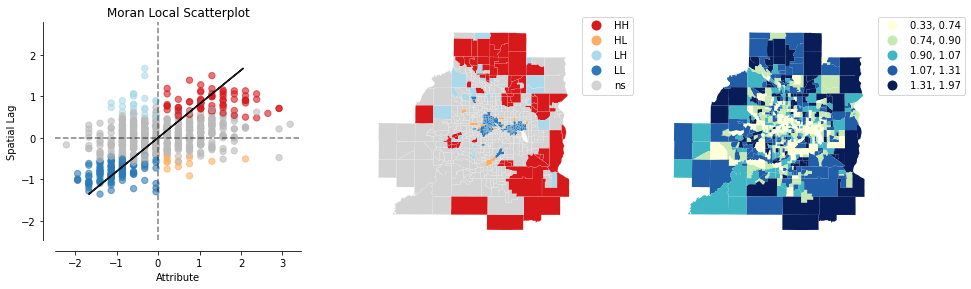

In [90]:
local_autocorrelation(tc_gdf, 'NBR_STAB')

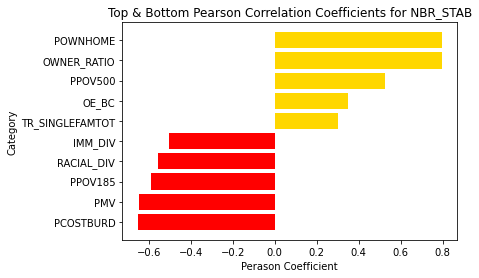

In [91]:
corr_pairs(tc_gdf, 'NBR_STAB')



#### Proportion who own home

Text(0.5, 1.0, 'Home Ownership Proportion')

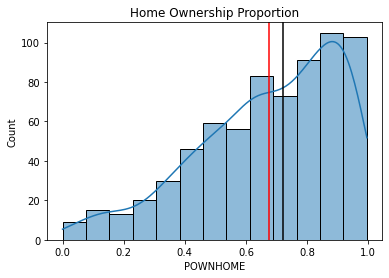

In [92]:
sns.histplot(x=tc_gdf['POWNHOME'], kde=True)
plt.axvline(tc_gdf['POWNHOME'].mean(), color = 'red')
plt.axvline(tc_gdf['POWNHOME'].median(), color = 'k')
plt.title('Home Ownership Proportion')


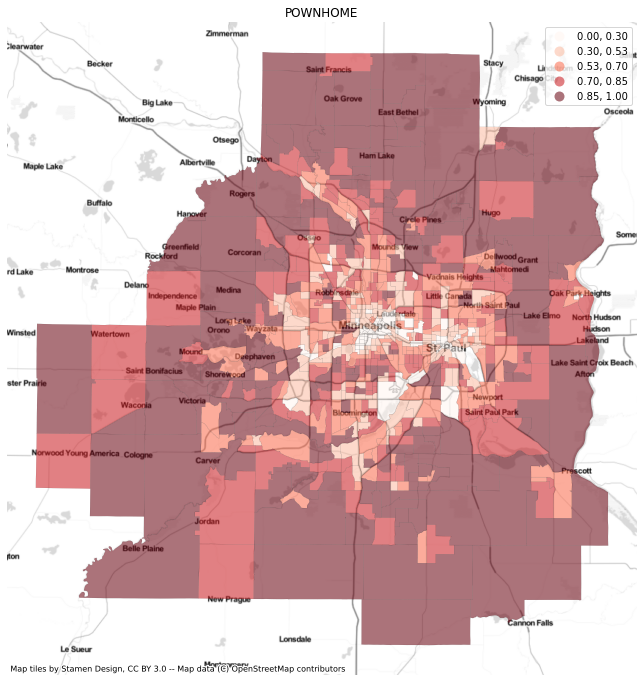

In [93]:
choro(tc_gdf, 'POWNHOME')

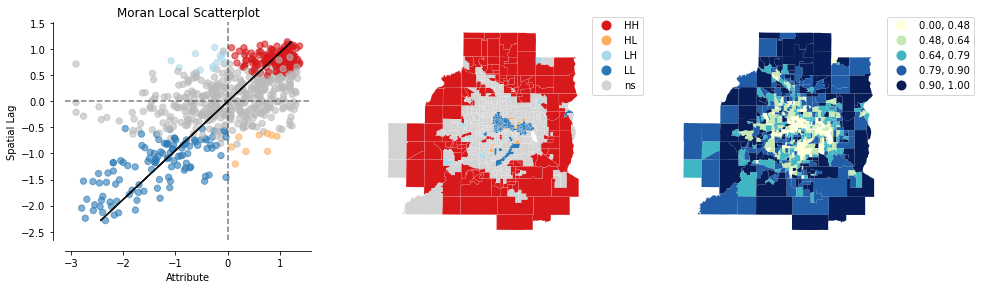

In [94]:
local_autocorrelation(tc_gdf, 'POWNHOME')

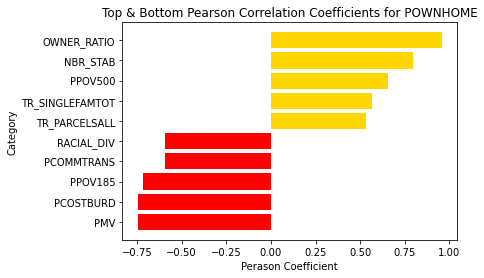

In [95]:
corr_pairs(tc_gdf, 'POWNHOME')

Suburban home ownership rates are significantly higher, with border tracts circling the city. There does seem to be greater variation in working class suburbs. Strong negative correlations with people moving often and cost burdened.

#### Cost Burdened
Paying more than 30% in home expenses (rent or mortgage)

Text(0.5, 1.0, 'Housing Cost Burdened')

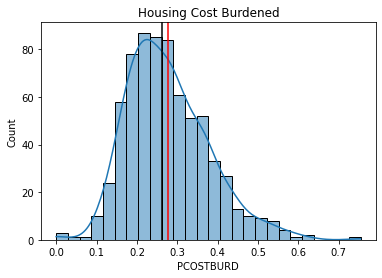

In [96]:
sns.histplot(x=tc_gdf['PCOSTBURD'], kde=True)
plt.axvline(tc_gdf['PCOSTBURD'].mean(), color = 'red')
plt.axvline(tc_gdf['PCOSTBURD'].median(), color = 'k')
plt.title('Housing Cost Burdened')


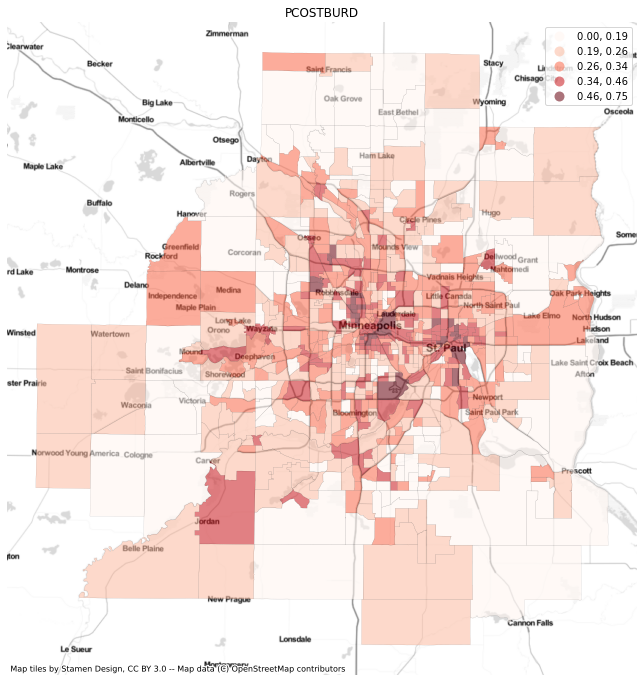

In [97]:
choro(tc_gdf, 'PCOSTBURD')

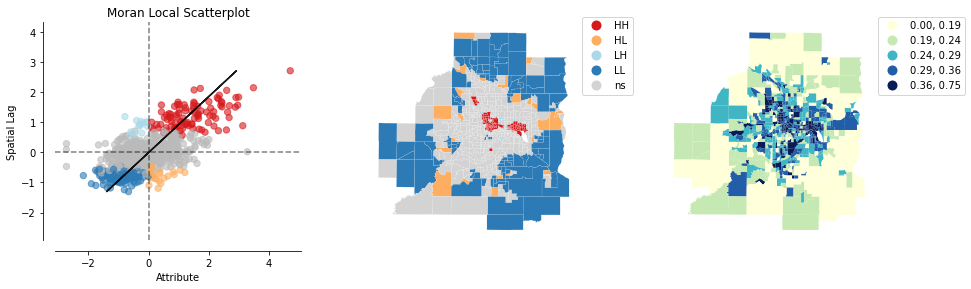

In [98]:
local_autocorrelation(tc_gdf, 'PCOSTBURD')

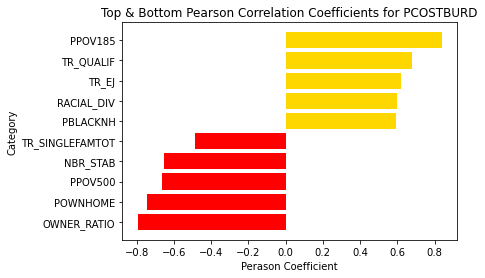

In [99]:
corr_pairs(tc_gdf, 'PCOSTBURD')

Not surprisingly, cost burdened people are also low income and higher ratios of POC, and much lower home ownership rates, and in tracts dominated by single family homes.

#### Net Change in Housing Unites (2014-2019)

Text(0.5, 1.0, 'Net Change in Housing Units, 2014-2019')

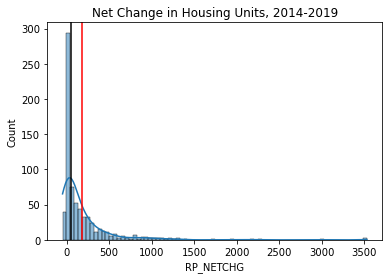

In [100]:
sns.histplot(x=tc_gdf['RP_NETCHG'], kde=True)
plt.axvline(tc_gdf['RP_NETCHG'].mean(), color = 'red')
plt.axvline(tc_gdf['RP_NETCHG'].median(), color = 'k')
plt.title('Net Change in Housing Units, 2014-2019')


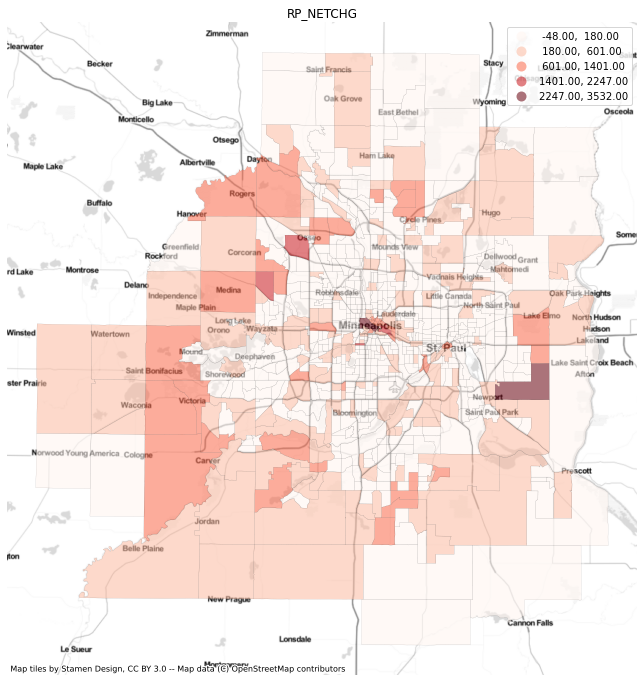

In [101]:
choro(tc_gdf, 'RP_NETCHG')

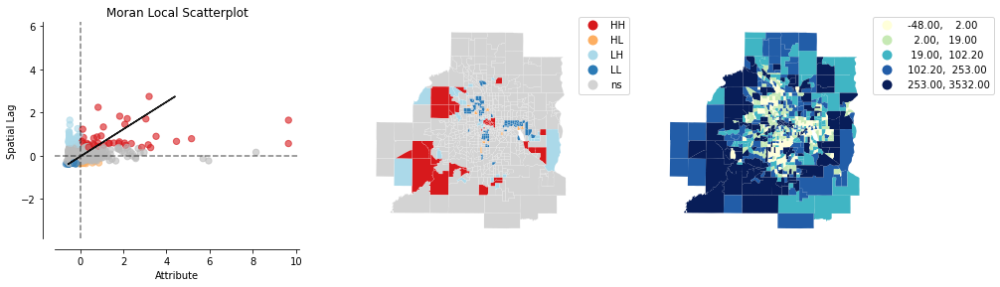

In [102]:
local_autocorrelation(tc_gdf, 'RP_NETCHG')

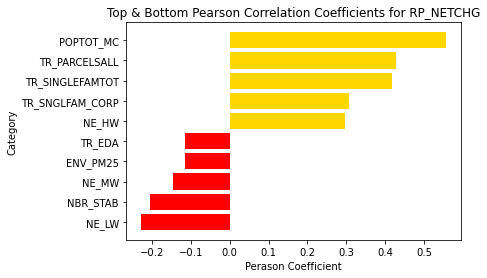

In [103]:
corr_pairs(tc_gdf, 'RP_NETCHG')

New Housing units are either concentrated in the city where new multi-family projects are developed (correlated with more dense tracts with higher population, but also, interestingly, with new single-family development in the suburbs, largely built in single-family housing developments and targeting New Economy High Wage earners (professionals). New units are strong not correlated with tracts with low wage and middle wage earners.

#### Owner Ratio

Text(0.5, 1.0, 'Home Ownership Ratio')

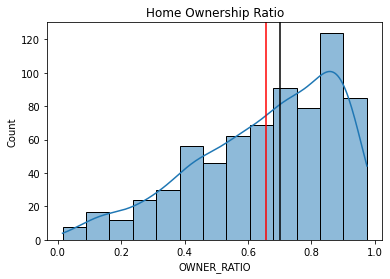

In [104]:
sns.histplot(x=tc_gdf['OWNER_RATIO'], kde=True)
plt.axvline(tc_gdf['OWNER_RATIO'].mean(), color = 'red')
plt.axvline(tc_gdf['OWNER_RATIO'].median(), color = 'k')
plt.title('Home Ownership Ratio')


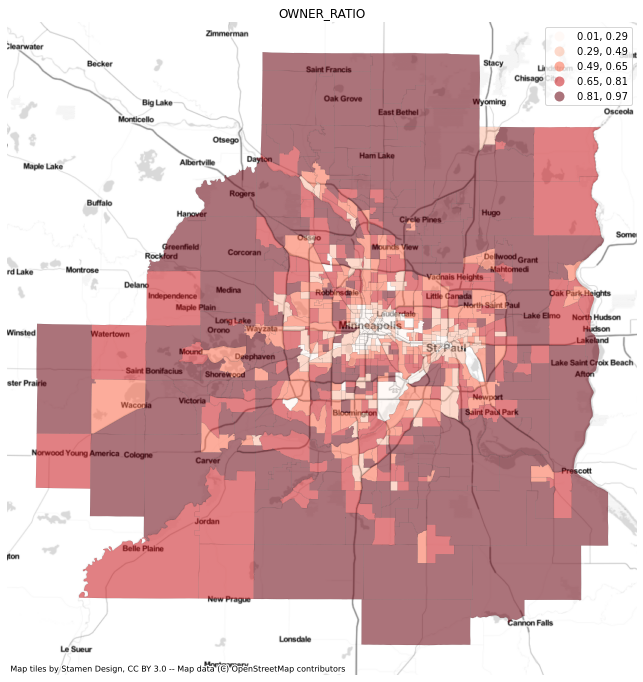

In [105]:
choro(tc_gdf, 'OWNER_RATIO')

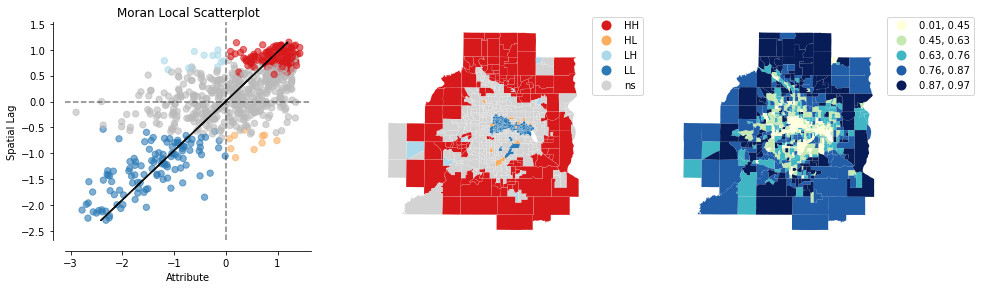

In [106]:
local_autocorrelation(tc_gdf, 'OWNER_RATIO')

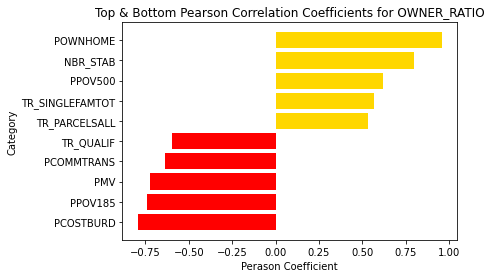

In [107]:
corr_pairs(tc_gdf, 'OWNER_RATIO')

POWNHOME and OWNER RATIO are redundant. Will delete one for analysis.

#### Rent Change from 2014-2019

Text(0.5, 1.0, 'Rent Change')

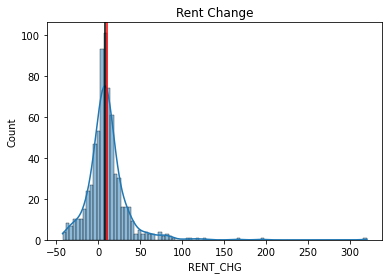

In [108]:
# To to find parcels with -100 to understand what happened here.
sns.histplot(x=tc_gdf['RENT_CHG'], kde=True)
plt.axvline(tc_gdf['RENT_CHG'].mean(), color = 'red')
plt.axvline(tc_gdf['RENT_CHG'].median(), color = 'k')
plt.title('Rent Change')


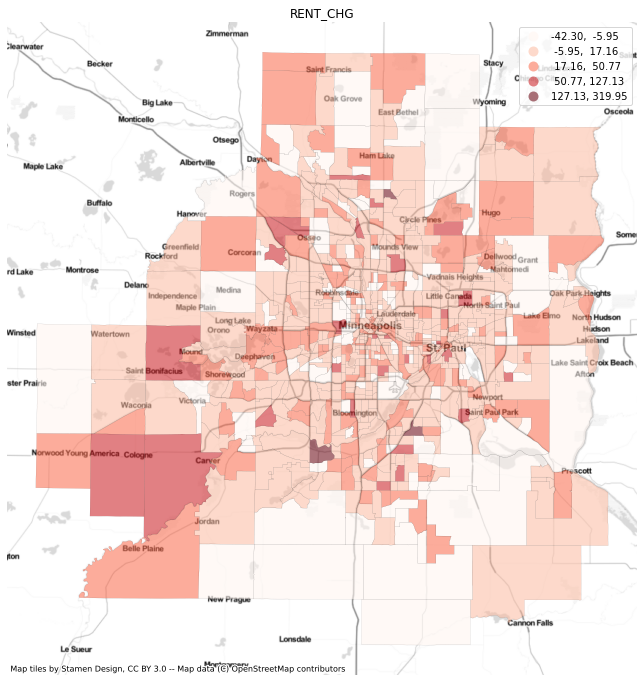

In [109]:
choro(tc_gdf, 'RENT_CHG')

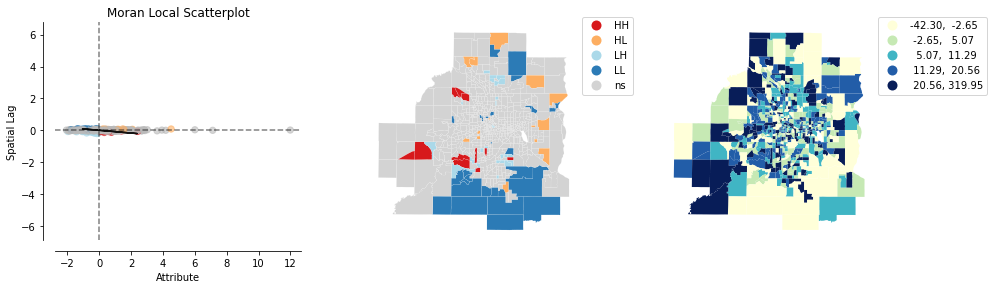

In [110]:
local_autocorrelation(tc_gdf, 'RENT_CHG')

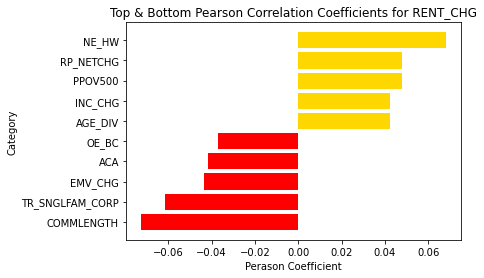

In [111]:
corr_pairs(tc_gdf, 'RENT_CHG')

still assessing

#### Estimated Median Value Change

Text(0.5, 1.0, 'Age Diversity Index')

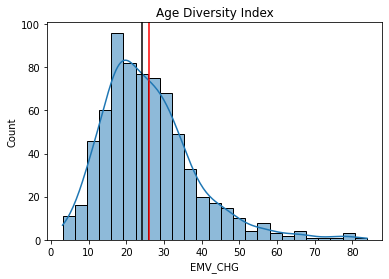

In [112]:
sns.histplot(x=tc_gdf['EMV_CHG'], kde=True)
plt.axvline(tc_gdf['EMV_CHG'].mean(), color = 'red')
plt.axvline(tc_gdf['EMV_CHG'].median(), color = 'k')
plt.title('Age Diversity Index')


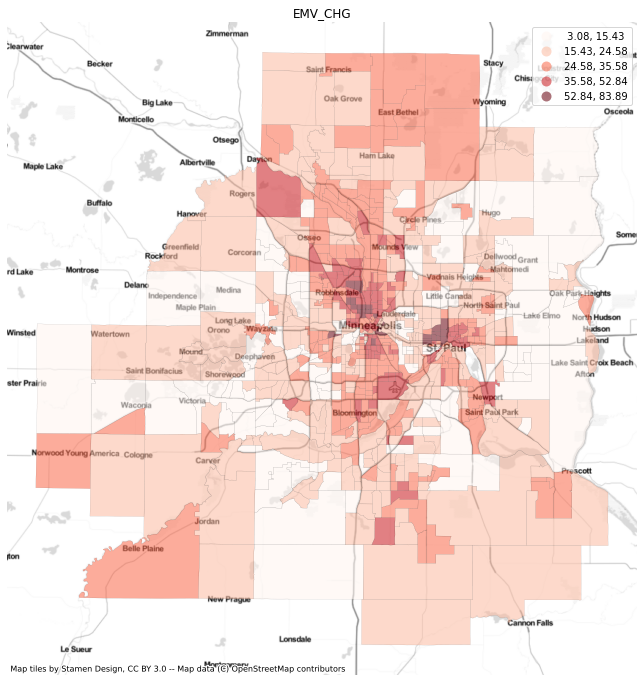

In [113]:
choro(tc_gdf, 'EMV_CHG')

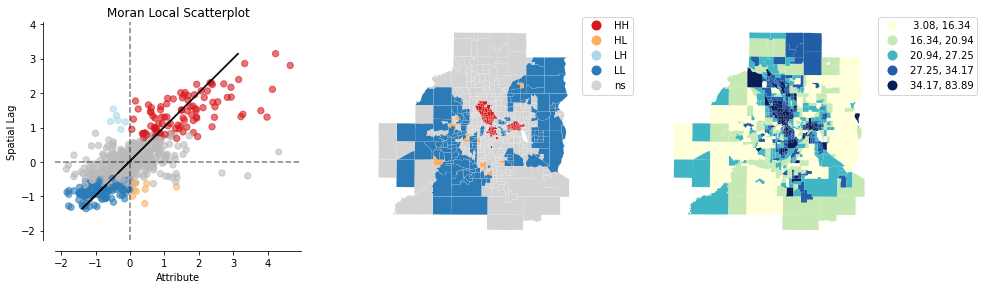

In [114]:
local_autocorrelation(tc_gdf, 'EMV_CHG')

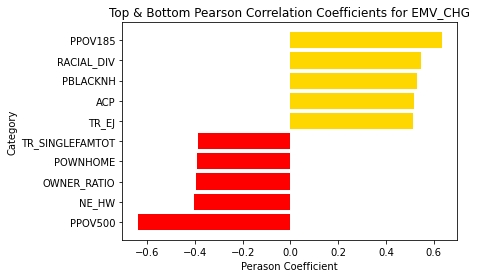

In [115]:
corr_pairs(tc_gdf, 'EMV_CHG')

Strong increases in home values in areas where corporate ownership is high (North Minneapolis, south minneapolis, and the western sections of St Paul. More stable home values (less radical increases) are concentrated in wealthy neighborhoods. The most rapid increase are in poor and diverse neighborhoods, far outpacing wage growth.

## Parcel Derived Variables
Parcel Derived Variables
- `MED_YRBUILT` - Median year built of parcels in the tract
- `RATIO_CORPSF` - `TR_SNGLFAM_CORP`/`TR_SINGLEFAMTOT` - ratio of all single family parcels owned by a corporation
- `RATIO_NOTMNMF` - `MFOWN_NOTMN`/`TR_MULTIFAM_ALL` - ratio of all multifamily parcels in the tract owned out of state

#### Median Year Built

Text(0.5, 1.0, 'Median Year Built')

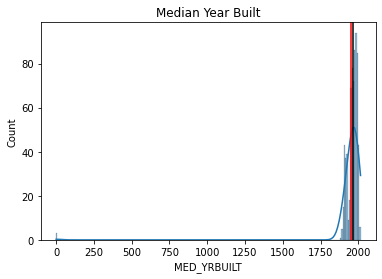

In [116]:
sns.histplot(x=tc_gdf['MED_YRBUILT'], kde=True)
plt.axvline(tc_gdf['MED_YRBUILT'].mean(), color = 'red')
plt.axvline(tc_gdf['MED_YRBUILT'].median(), color = 'k')
plt.title('Median Year Built')


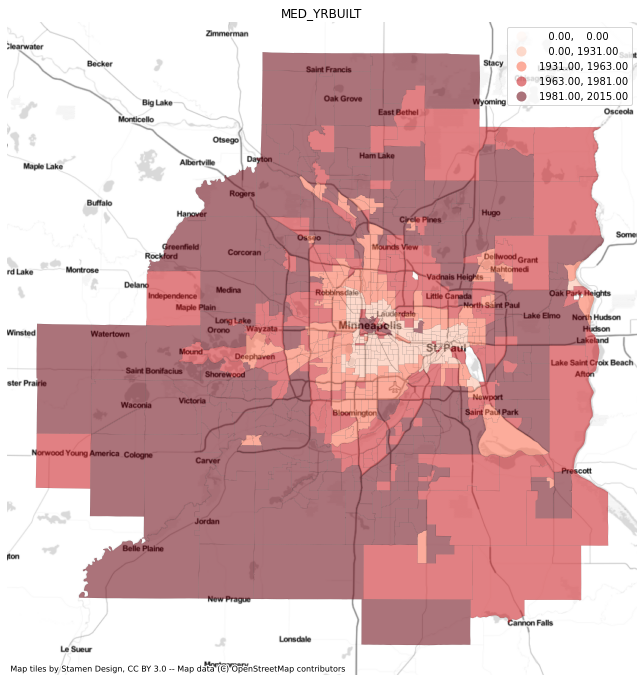

In [117]:
choro(tc_gdf, 'MED_YRBUILT')

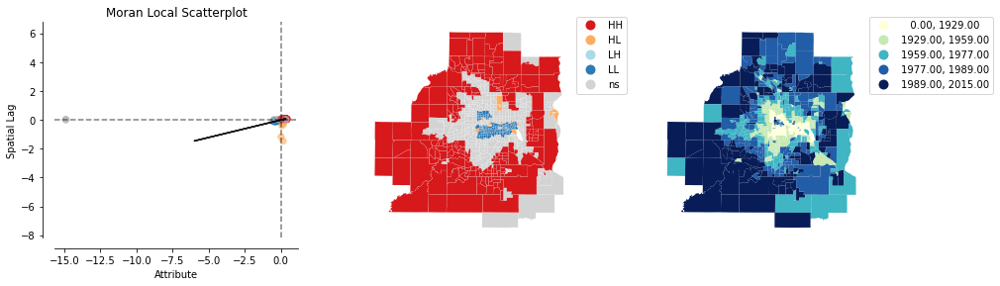

In [118]:
local_autocorrelation(tc_gdf, 'MED_YRBUILT')

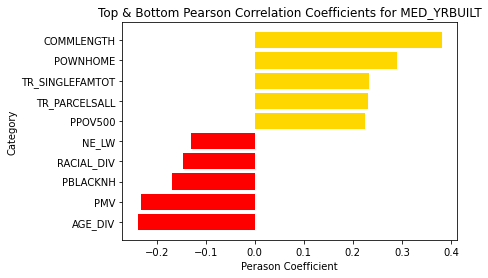

In [119]:
corr_pairs(tc_gdf, 'MED_YRBUILT')

Tracts with newer homes have longer commutes (further out), and are more likely to be in single_family neighborhoods, or highly dense urban neighbrhoods. As house age gets newer, neighborhood stability decreases, which makes sense that very new neighborhoods will have people who have lived there for not very long.

#### Ratio Single Family Parcels Corporate Owned
This is largely for visualization, but will be removed from the parcel modeling.

Text(0.5, 1.0, 'Ratio Corporate Owned Single Family')

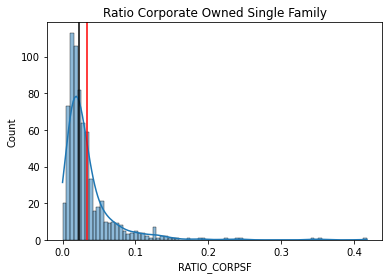

In [120]:
# Interesting that there are some tracts where corporate ownership is high - strong clustering behavior.
sns.histplot(x=tc_gdf['RATIO_CORPSF'], kde=True)
plt.axvline(tc_gdf['RATIO_CORPSF'].mean(), color = 'red')
plt.axvline(tc_gdf['RATIO_CORPSF'].median(), color = 'k')
plt.title('Ratio Corporate Owned Single Family')


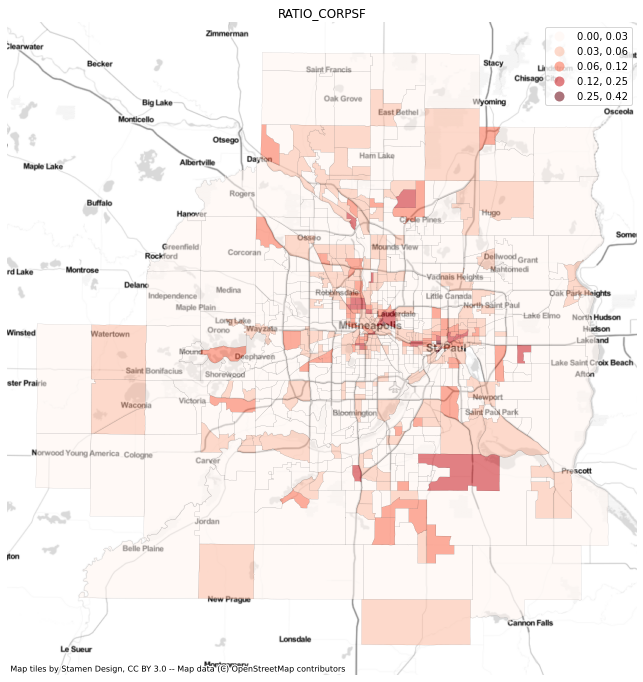

In [121]:
choro(tc_gdf, 'RATIO_CORPSF')


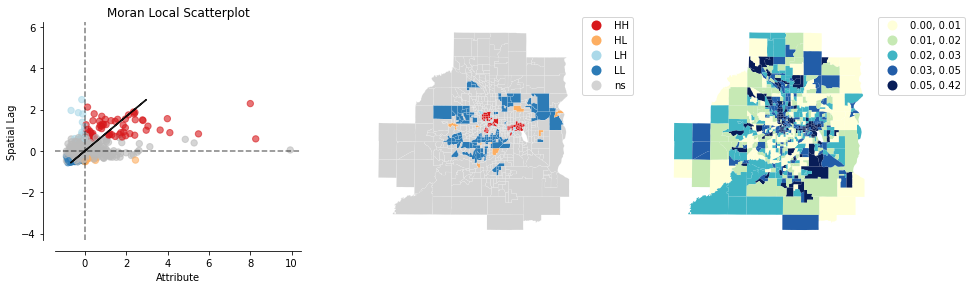

In [122]:
local_autocorrelation(tc_gdf, 'RATIO_CORPSF')


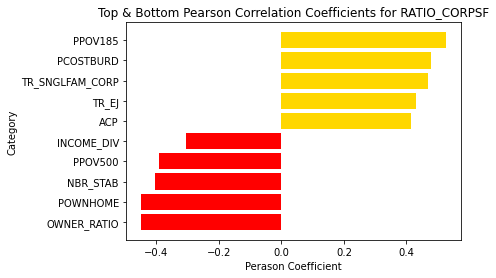

In [123]:
corr_pairs(tc_gdf, 'RATIO_CORPSF')


Some interesting things to observe. There are strong HH clusters in neighborhoods marked by lower household incomes and areas of concecntrated poverty. ALso interesting that there are less LL clusters, so there is some general dispersion of corporate ownership that makes low amounts of corporate ownership uncommon Higher corporate ownership, unsurprisingly, is also correlated with less home owners, because the homes are rented out. 

#### Ratio of Multi-family properties owned by out of state corporations
RATIO_NOTMNMF

Text(0.5, 1.0, 'Out of State Multi-Family Ownership Ratio')

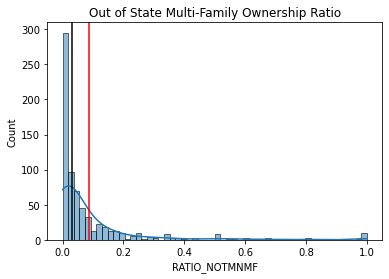

In [124]:
sns.histplot(x=tc_gdf['RATIO_NOTMNMF'], kde=True)
plt.axvline(tc_gdf['RATIO_NOTMNMF'].mean(), color = 'red')
plt.axvline(tc_gdf['RATIO_NOTMNMF'].median(), color = 'k')
plt.title('Out of State Multi-Family Ownership Ratio')


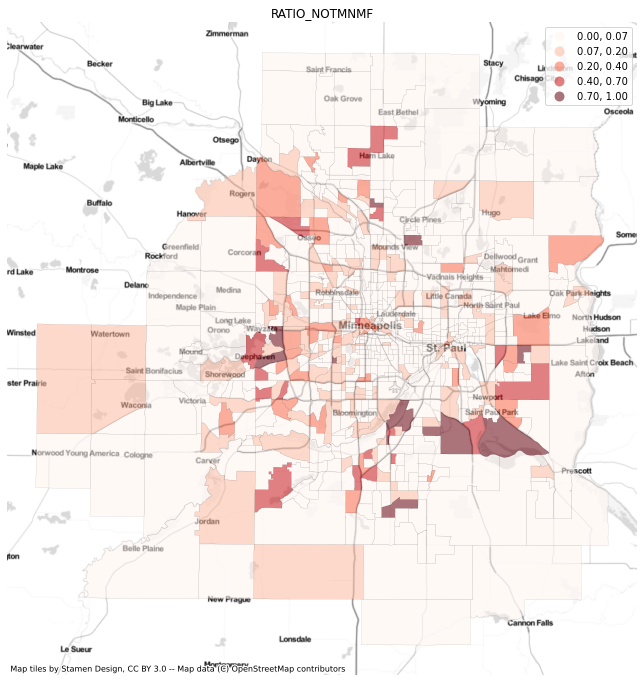

In [125]:
choro(tc_gdf, 'RATIO_NOTMNMF')

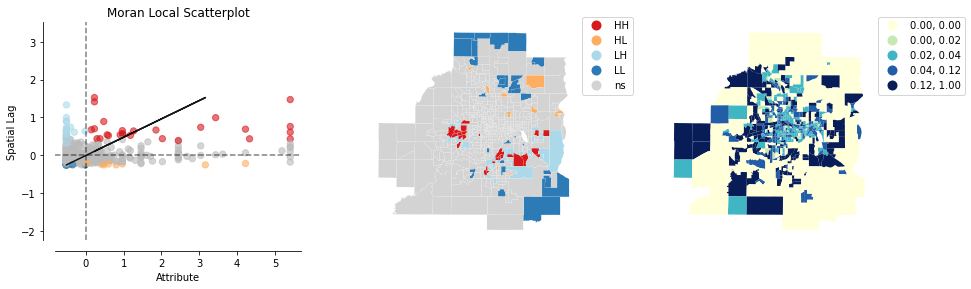

In [126]:
local_autocorrelation(tc_gdf, 'RATIO_NOTMNMF')

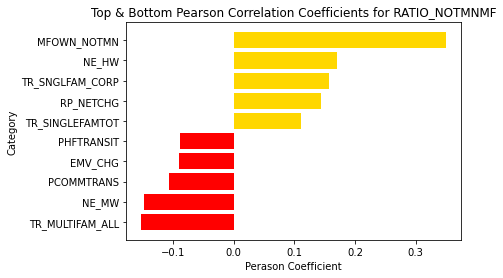

In [127]:
corr_pairs(tc_gdf, 'RATIO_NOTMNMF')

The spatial logic here is interesting. Highest rates of out of state ownership are concetrated near large fortune 500 corporations west of the city and in the southeast near the airport. Uncertain!

# Point Analysis of the Corporate Parcel Dataset

In [128]:
parcels = gpd.read_file('twincities_parcels.gpkg')

In [129]:
# Attributes and non-null counts look good (we will probably turn homestead into a binary)
parcels.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 968441 entries, 0 to 968440
Data columns (total 12 columns):
 #   Column          Non-Null Count   Dtype   
---  ------          --------------   -----   
 0   COUNTY_PIN      968441 non-null  object  
 1   County          968441 non-null  object  
 2   TAX_NAME        968441 non-null  object  
 3   taxed_zip       968441 non-null  object  
 4   Use_Class       968441 non-null  object  
 5   Last_Sale_Date  968441 non-null  int64   
 6   YEAR_BUILT      968441 non-null  int64   
 7   EMV_TOTAL       968441 non-null  float64 
 8   Homestead       968441 non-null  int64   
 9   Corporate       968441 non-null  int64   
 10  TAXOWN_NOTMN    968441 non-null  int64   
 11  geometry        968441 non-null  geometry
dtypes: float64(1), geometry(1), int64(5), object(5)
memory usage: 88.7+ MB


In [130]:
parcels.head()

,COUNTY_PIN,County,TAX_NAME,taxed_zip,Use_Class,Last_Sale_Date,YEAR_BUILT,EMV_TOTAL,Homestead,Corporate,TAXOWN_NOTMN,geometry
0,363425420001,Anoka,VESTA MINNESOTA PROPERTIES LLC,55443,Single_Family,2011,1987,343900.0,0,1,0,POINT (468988.693 5026377.395)
1,363425410007,Anoka,"BRIERLEY, WENDY LOU",55070,Single_Family,2015,1996,382700.0,1,0,0,POINT (469548.186 5026281.306)
2,363425410006,Anoka,FOSSE DAVID B & ELVIRA,55070,Single_Family,1996,1996,537900.0,1,0,0,POINT (469374.511 5026384.153)
3,363425410005,Anoka,GARAGHTY PATRICK J & DEBRA K,55070,Single_Family,1998,1998,354000.0,1,0,0,POINT (469323.226 5026492.734)
4,363425410004,Anoka,LEVAN MICHAEL,55070,Single_Family,2021,1995,288900.0,0,0,0,POINT (469536.277 5026429.696)


In [131]:
print(f'The parcels dataframe contains {parcels.shape[0]} entries and {parcels.shape[1]} attributes.')

The parcels dataframe contains 968441 entries and 12 attributes.


In [132]:
#Coordinate system
parcels.crs

<Derived Projected CRS: EPSG:26915>
Name: NAD83 / UTM zone 15N
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: North America - between 96°W and 90°W - onshore and offshore. Canada - Manitoba; Nunavut; Ontario. United States (USA) - Arkansas; Illinois; Iowa; Kansas; Louisiana; Michigan; Minnesota; Mississippi; Missouri; Nebraska; Oklahoma; Tennessee; Texas; Wisconsin.
- bounds: (-96.0, 25.61, -90.0, 84.0)
Coordinate Operation:
- name: UTM zone 15N
- method: Transverse Mercator
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [133]:
# Some visualization in Seaborn is made easier with x,y coordinate points (create x y points from geometry file)
parcels['x'] = parcels.geometry.x
parcels['y'] = parcels.geometry.y
parcels.head()

,COUNTY_PIN,County,TAX_NAME,taxed_zip,Use_Class,Last_Sale_Date,YEAR_BUILT,EMV_TOTAL,Homestead,Corporate,TAXOWN_NOTMN,geometry,x,y
0,363425420001,Anoka,VESTA MINNESOTA PROPERTIES LLC,55443,Single_Family,2011,1987,343900.0,0,1,0,POINT (468988.693 5026377.395),468988.6928,5.026377e+06
1,363425410007,Anoka,"BRIERLEY, WENDY LOU",55070,Single_Family,2015,1996,382700.0,1,0,0,POINT (469548.186 5026281.306),469548.1858,5.026281e+06
2,363425410006,Anoka,FOSSE DAVID B & ELVIRA,55070,Single_Family,1996,1996,537900.0,1,0,0,POINT (469374.511 5026384.153),469374.5113,5.026384e+06
3,363425410005,Anoka,GARAGHTY PATRICK J & DEBRA K,55070,Single_Family,1998,1998,354000.0,1,0,0,POINT (469323.226 5026492.734),469323.2261,5.026493e+06
4,363425410004,Anoka,LEVAN MICHAEL,55070,Single_Family,2021,1995,288900.0,0,0,0,POINT (469536.277 5026429.696),469536.2772,5.026430e+06


The workplan is to do some basic exploration and visualization of the parcels dataset, including a spatial understanding of where they're located and spatial clustering behavior.

First, lets do some basic cutting up of our data.

#### What proportion of single family homes are corporate owned?

In [134]:
parcels.Use_Class.value_counts()

Single_Family        929055
Multifamily_Small     21891
Multifamily_Large     17495
Name: Use_Class, dtype: int64

In [135]:
# Corporate owned housing as percent of total

residential = parcels.loc[(parcels['Use_Class'] == 'Single_Family') | (parcels['Use_Class'] == 'Multifamily_Small')]
single_fam_res_notcorp = residential.loc[residential['Corporate'] ==0]
single_fam_res_corp = residential.loc[(residential['Corporate'] ==1)]
print(f'The percentage of residential homes owned by corporations: \
{single_fam_res_corp.shape[0]/residential.shape[0]*100}%')

The percentage of residential homes owned by corporations: 3.200602347557064%


While the overall number of single family homes bought by corporations is relatively small, has that proportion increased for homes bought since 2008?

In [136]:
#Corporate owned housing purchased since 2009

homes_since_2009 = residential.loc[residential['Last_Sale_Date'] > 2008]
corporate_homes_since_2009 = homes_since_2009.loc[(homes_since_2009['Corporate'] ==1)]
print(f'The percentage of small residential homes owned by corporations bought since 2009: \
{corporate_homes_since_2009.shape[0]/homes_since_2009.shape[0]*100}%')

The percentage of small residential homes owned by corporations bought since 2009: 4.223769117422895%


The broader metro region contains a relatively small percentage of single family homes owned by corporate investors compared to other metro regions. If corporate homes were evenly spread across the entire metro area, the impact of corporate ownership may be diffuse. However, if corporate ownership is clustered in space, even a handful of corporate owned homes can have an impact on both how expensive homes are (price inflation that others than meet), or rents (by drastically increasing rents, establishing a new market average for a region). Our next question, then, are corporately owned homes clustered in the Twin Cities region?

#### Where are corporate owned homes located?

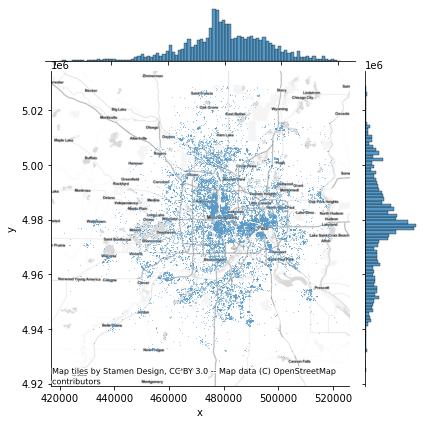

In [137]:
# Visualize clustering
#scatter plot
joint_axes = sns.jointplot(x='x', y='y', data=single_fam_res_corp, s=0.5)

#add basemap
cx.add_basemap(joint_axes.ax_joint, crs=parcels.crs, source=cx.providers.Stamen.TonerLite)
cx.add_basemap(joint_axes.ax_joint, source=cx.providers.Stamen.TonerLabels, zoom=10)


Text(0.5, 1.0, 'Neighborhooods with high corporate ownership')

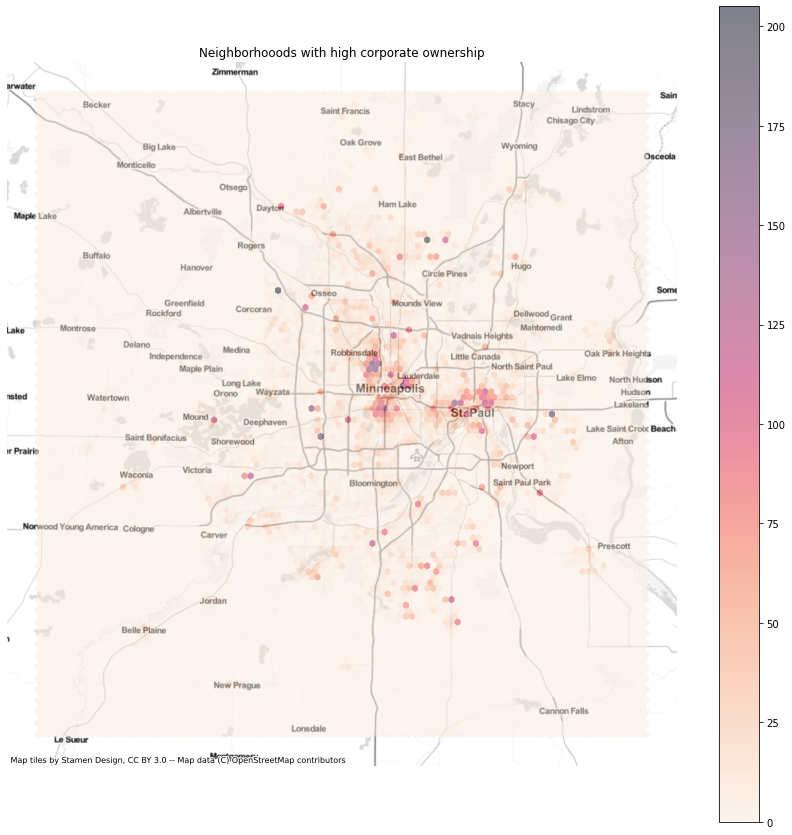

In [138]:

# Set up figure and axis
f, ax = plt.subplots(1, figsize=(15, 15))
# Generate and add hexbin with 100 containers
hb = ax.hexbin(single_fam_res_corp['x'], single_fam_res_corp['y'], gridsize=100, linewidths=0, alpha=0.5, cmap='rocket_r')
# Add basemap
cx.add_basemap(ax, crs=parcels.crs, source=cx.providers.Stamen.TonerLite)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLabels, zoom=10)

# Add colorbar
plt.colorbar(hb)
# Remove axes
ax.set_axis_off()
ax.set_title('Neighborhooods with high corporate ownership')

C:\Users\scox0\anaconda3\envs\geo_env\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


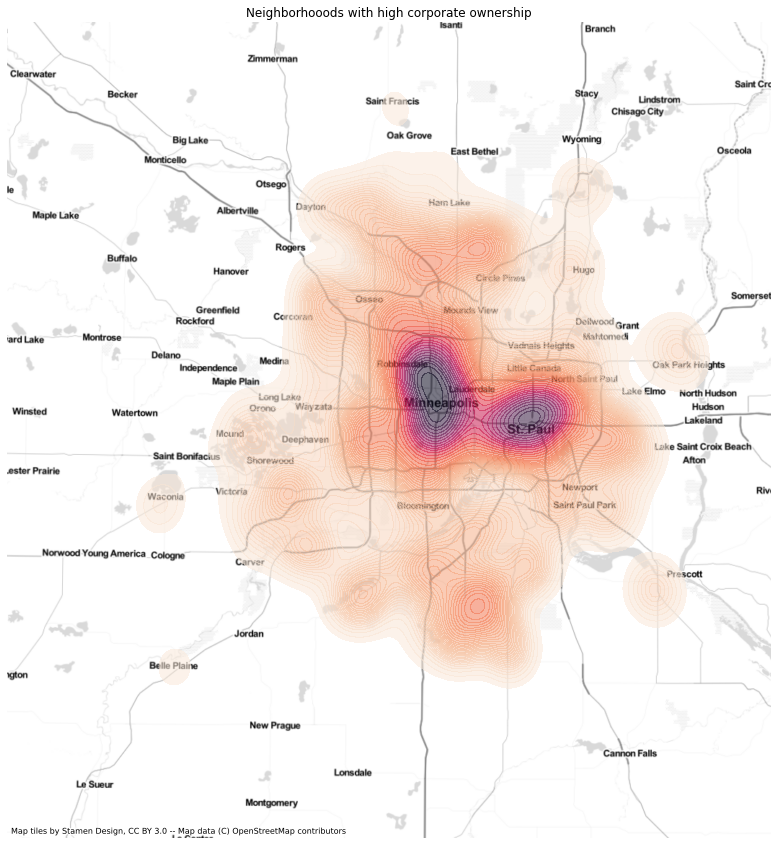

In [139]:
# Set up figure and axis
f, ax = plt.subplots(1, figsize=(15, 15))
# Generate and add KDE with a shading of 50 gradients coloured contours, 75% of transparency,
sns.kdeplot(single_fam_res_corp['x'], single_fam_res_corp['y'], n_levels=50, shade=True, alpha=0.55, cmap='rocket_r')
# Add basemap
cx.add_basemap(ax, crs=parcels.crs, source=cx.providers.Stamen.TonerLite)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLabels, zoom=10)

# Remove axes
ax.set_axis_off()
ax.set_title('Neighborhooods with high corporate ownership')

plt.savefig('charts/corporateownership.png')

Statistical measures for spatial clustering for point data: We will use the Quadrat Statistic that seeks to understand if points in space are randomly distributed (Complete Spatial Randomness) or if the processes driving the pattern of data have a spatial structure. Information on the quadrat statistic can be found [here](https://pysal.org/notebooks/explore/pointpats/Quadrat_statistics.html). The QStatistic established a grid over the study area and measures the number of observations within each grid point, and uses a $\chi^2$ statistic test to examine the eveness over space.

In [140]:
from pointpats import QStatistic, PointPattern

coordinates = single_fam_res_corp[['x', 'y']].values

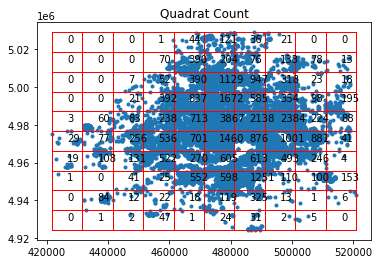

In [141]:
import pointpats.quadrat_statistics as qs


qstat = qs.QStatistic(coordinates, shape='rectangle', nx = 10, ny = 10)
qstat.plot()

In [142]:
print(f'The Chi2 for the distribution of corporate parcels is: {qstat.chi2}')
print(f'The analytical p-value is: {qstat.chi2_pvalue}')

The Chi2 for the distribution of corporate parcels is: 107685.46799842292
The analytical p-value is: 0.0


With a very low p-value, we can reject the null hypotheses that the points are randomly distributed in space, indicating that there is a spatial structure to corporate single-family real estate investment.

#### Let's dig a little deeper:


Some preliminary observations, corporate ownership of residential properties remains highest in the city, and predominantly new economy low wage and mid-wage working class neighborhoods both in the city proper and the suburbs. My intuition here says there are two main groups: 1) Foreclosed homes purchased *en masse* during the Great Recession, providing lower transaction costs for corporate buyers, and 2) New Home construction south of the city, interestingly targeting lower wage markets where people may not have the savings for a down payment, but want a single-family suburban house.

#### When were corporate owned houses purchased?

Text(0.5, 1.0, 'The Last Sale Date of Corporate Owned Houses')

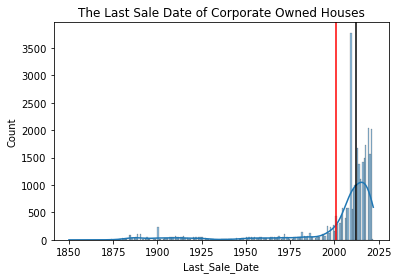

In [143]:
sns.histplot(single_fam_res_corp['Last_Sale_Date'], kde=True)
plt.axvline(single_fam_res_corp['Last_Sale_Date'].mean(), color = 'red')
plt.axvline(single_fam_res_corp['Last_Sale_Date'].median(), color = 'k')
plt.title('The Last Sale Date of Corporate Owned Houses')

Interestingly, yes, there is a large spike at the recession, and a really large increase in the last three years. Let's zoom in.

In [144]:
# Examine the years with the 10 most properties acquired by a corporate investor
last_sale_date_corporate = single_fam_res_corp['Last_Sale_Date'].value_counts()

# turn into DF
properties_by_year = last_sale_date_corporate.to_frame().reset_index()

#identify top 10
top_years = properties_by_year.head(10)

#reset index
top_years = top_years.rename(columns={'index': 'Year', 'Last_Sale_Date': 'Total'})

In [145]:
top_years

,Year,Total
0,2009,3779
1,2019,2045
2,2021,2032
3,2018,1734
4,2013,1680
5,2020,1576
6,2017,1493
7,2016,1423
8,2014,1394
9,2015,1119


Text(0.5, 1.0, 'Number of Properties by Last Sale Date (Top 10)')

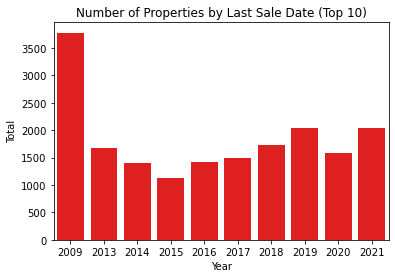

In [146]:
#Plot the top ten years for sales
sns.barplot(x ='Year', y = 'Total', data =top_years, color='red')
plt.title('Number of Properties by Last Sale Date (Top 10)')


#### Are there differing geographical patterns to the different groups?

I want to look at three main groups:
    
    1) Group 1 - post recession purchases at deflated values, including foreclosures (ie: Blackrock Pre-Invitation Homes)
    
    2) Group 2 - purchases during the quantitative easing era at the fed (2014-2019)
    
    3) Group 3 - Post-pandemic - 2020/2021

In [147]:
# Group 1
post_recession_corp = single_fam_res_corp.loc[(single_fam_res_corp['Last_Sale_Date'] >= 2008) & (single_fam_res_corp['Last_Sale_Date'] <= 2013)]

# Group 2
qe_corp = single_fam_res_corp.loc[(single_fam_res_corp['Last_Sale_Date'] > 2013) & (single_fam_res_corp['Last_Sale_Date'] < 2020)]

# Group 3
covid19_corp = single_fam_res_corp.loc[single_fam_res_corp['Last_Sale_Date'] >= 2020]


Text(0.5, 1.0, 'Corporate Purchasing After the Recession')

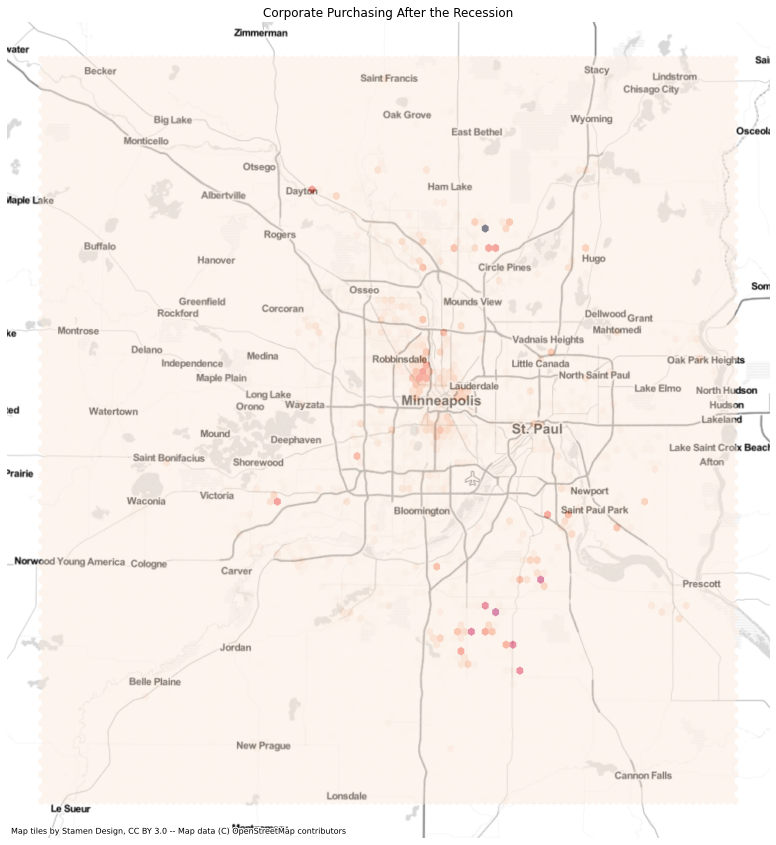

In [148]:
# Heatmap for Post-Recession Purchases

# Set up figure and axis
f, ax = plt.subplots(1, figsize=(15, 15))
# Generate and add KDE with a shading of 50 gradients coloured contours, 75% of transparency,
hb = ax.hexbin(post_recession_corp['x'], post_recession_corp['y'], gridsize=100, linewidths=0, alpha=0.5, cmap='rocket_r')
# Add basemap
cx.add_basemap(ax, crs=parcels.crs, source=cx.providers.Stamen.TonerLite)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLabels, zoom=10)

# Remove axes
ax.set_axis_off()
ax.set_title('Corporate Purchasing After the Recession')


Text(0.5, 1.0, 'Corporate Purchasing During QE')

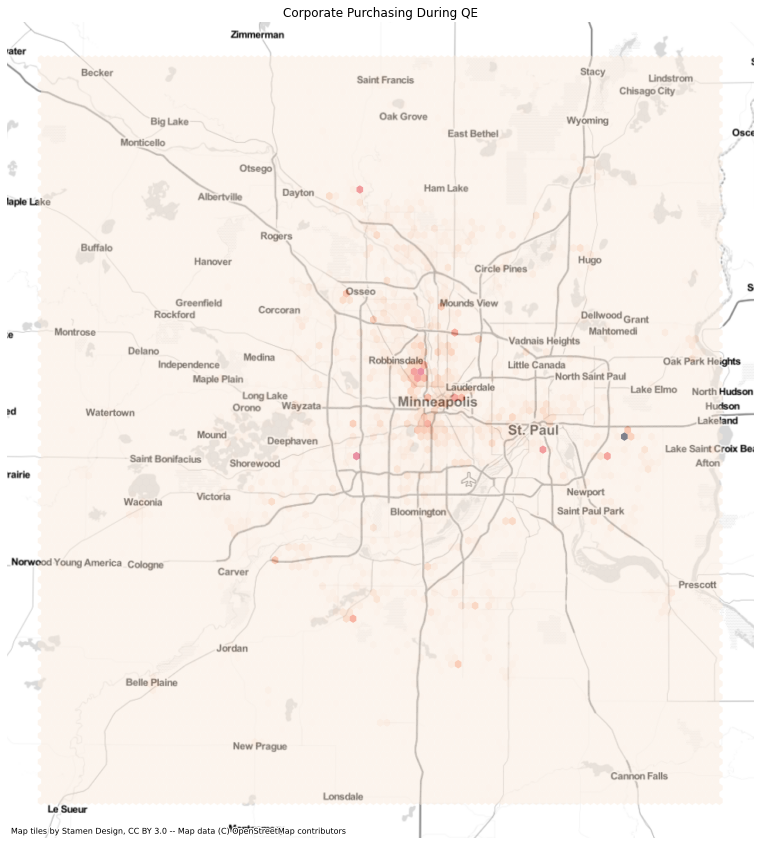

In [149]:
# Set up figure and axis
f, ax = plt.subplots(1, figsize=(15, 15))
# Generate and add KDE with a shading of 50 gradients coloured contours, 75% of transparency,
hb = ax.hexbin(qe_corp['x'], qe_corp['y'], gridsize=100, linewidths=0, alpha=0.5, cmap='rocket_r')
# Add basemap
cx.add_basemap(ax, crs=parcels.crs, source=cx.providers.Stamen.TonerLite)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLabels, zoom=10)

# Remove axes
ax.set_axis_off()
ax.set_title('Corporate Purchasing During QE')


Text(0.5, 1.0, 'Corporate Purchasing During Covid-19 Pandemic')

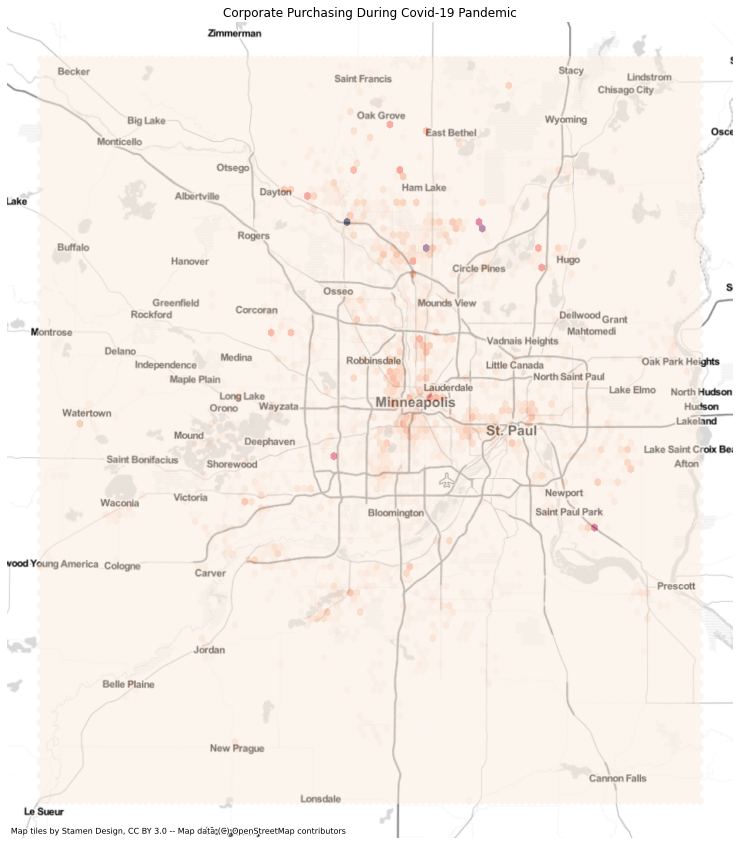

In [150]:
# Set up figure and axis
f, ax = plt.subplots(1, figsize=(15, 15))
# Generate and add KDE with a shading of 50 gradients coloured contours, 75% of transparency,
hb = ax.hexbin(covid19_corp['x'], covid19_corp['y'], gridsize=100, linewidths=0, alpha=0.5, cmap='rocket_r')
# Add basemap
cx.add_basemap(ax, crs=parcels.crs, source=cx.providers.Stamen.TonerLite)
cx.add_basemap(ax, source=cx.providers.Stamen.TonerLabels, zoom=10)

# Remove axes
ax.set_axis_off()
ax.set_title('Corporate Purchasing During Covid-19 Pandemic')



What we do tend to see in these patterns is that after the recession, corporate housing investors targeted foreclosed homes in the neighborhoods most heavily hit by the crisis: Neighborhoods with higher rates of people of color (in particular black people) historically excluded from home ownership and in tenuous positions in the low wage service sector economy, and suburban low wage, working class suburbs. During the QE period, many of the strategies remained in place, but it appears greater emphasis as well on rapidly gentrifying urban neighborhoods, as well as continued investment into North Minneapolis. During the pandemic, patterns shifted towards the suburbs, with urban purchases declining, as corporate investors predicted increased interest for more space away from dense urban neighborhoods, perhaps exarcebated in the Twin Cities due to the George Floyd uprising.

Did the median value of homes pursued by corporate purchasers change over time?

In [151]:
print(f'the median for post recession corporate owned housing is: {post_recession_corp.EMV_TOTAL.median()}')
print(f'the median for the period of quantitative easing is: {qe_corp.EMV_TOTAL.median()}')
print(f'the median for the post-covid-19 period is: {covid19_corp.EMV_TOTAL.median()}')
print(f'the regional median is: {residential.EMV_TOTAL.median()}')

the median for post recession corporate owned housing is: 158250.0
the median for the period of quantitative easing is: 224350.0
the median for the post-covid-19 period is: 219900.0
the regional median is: 284200.0


In [152]:
median_values = {'Post Recesssion': 158250, 'Quantitative Easing': 224350, 'Post-Covid 19': 219900, 'Regional Median': 284200}

median_valuesdf = pd.DataFrame.from_dict(median_values, orient = 'index', columns = ['Median Value'])
median_valuesdf = median_valuesdf.reset_index()
median_valuesdf = median_valuesdf.rename(columns = {'index': 'Period'})
median_valuesdf.head()


,Period,Median Value
0,Post Recesssion,158250
1,Quantitative Easing,224350
2,Post-Covid 19,219900
3,Regional Median,284200


[Text(0.5, 1.0, 'Estimated Median Value of Corporate Acquired Properties Compared to Regional Median')]

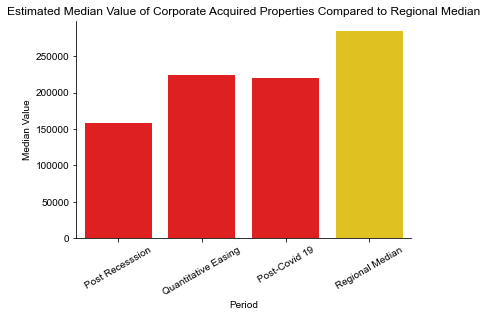

In [153]:
#Plot the top ten years for sales

ax = sns.barplot(data = median_valuesdf, x='Period', y='Median Value', palette = ['gold' if x=='Regional Median' else 'red' for x in median_valuesdf.Period])
ax.set_xticklabels(ax.get_xticklabels(), rotation =30)
sns.despine()
sns.set_style('dark')
ax.set(title='Estimated Median Value of Corporate Acquired Properties Compared to Regional Median')

Also interested in what percentage of all homes sold rather than just percentage of total homes period, were corporate owned,

In [154]:
residential.shape

(950946, 14)

In [155]:
post_covid_residential = residential.loc[residential['Last_Sale_Date'] >= 2020]

print(f'Corporate acquisitions make up {round(covid19_corp.shape[0]/post_covid_residential.shape[0] * 100, 2)}% of total homes purchased since the pandemic.')

Corporate acquisitions make up 3.14% of total homes purchased since the pandemic.


In [156]:
covid19_corp.County.value_counts()

Anoka         1112
Hennepin      1083
Ramsey         461
Washington     311
Scott          257
Dakota         247
Carver         154
Name: County, dtype: int64

#### Examining spatial patterns/correlation between each period of acquisition

Will merge the parcels dataset with the tracts dataset to explore

In [157]:
res_tract_gdf = residential.sjoin(tc_gdf, how = 'left', predicate = 'within')

In [158]:
res_tract_gdf.head()

,COUNTY_PIN,County,TAX_NAME,taxed_zip,Use_Class,Last_Sale_Date,YEAR_BUILT,EMV_TOTAL,Homestead,Corporate,TAXOWN_NOTMN,geometry,x,y,index_right,TR10,CTU_PRMRY,POPTOT_MC,AGE_DIV,IMM_DIV,RACIAL_DIV,PBLACKNH,PPOV185,ACP,PPOV500,ACA,TR_EDA,INCOME_DIV,INC_CHG,OE_BC,NE_LW,NE_MW,NE_HW,PHFTRANSIT,COMMLENGTH,PCOMMTRANS,PJOB_LT5,TR_EJ,ENV_PM25,PMV,NBR_STAB,POWNHOME,PCOSTBURD,RP_NETCHG,TR_QUALIF,OWNER_RATIO,RENT_CHG,EMV_CHG,AFF_CHG,TR_PARCELSALL,TR_SINGLEFAMTOT,TR_SNGLFAM_CORP,TR_MULTIFAM_ALL,MFOWN_NOTMN,MED_YRBUILT,RATIO_CORPSF,RATIO_NOTMNMF
0,363425420001,Anoka,VESTA MINNESOTA PROPERTIES LLC,55443,Single_Family,2011,1987,343900.0,0,1,0,POINT (468988.693 5026377.395),468988.6928,5.026377e+06,0.0,27003050107,St. Francis,3034.0,0.699942,0.0,0.076826,0.0,0.231,0.0,0.205,0.0,0.0,0.750102,6.059419,0.268156,0.299441,0.311173,0.121229,0.0,37.12,0.0,0.307,0.0,6.907,0.062,1.148986,0.922,0.296,33.0,0.0,0.88735,25.0,24.462236,-42.657741,840.0,833.0,22.0,7.0,0.0,1999.0,0.026411,0.0
1,363425410007,Anoka,"BRIERLEY, WENDY LOU",55070,Single_Family,2015,1996,382700.0,1,0,0,POINT (469548.186 5026281.306),469548.1858,5.026281e+06,0.0,27003050107,St. Francis,3034.0,0.699942,0.0,0.076826,0.0,0.231,0.0,0.205,0.0,0.0,0.750102,6.059419,0.268156,0.299441,0.311173,0.121229,0.0,37.12,0.0,0.307,0.0,6.907,0.062,1.148986,0.922,0.296,33.0,0.0,0.88735,25.0,24.462236,-42.657741,840.0,833.0,22.0,7.0,0.0,1999.0,0.026411,0.0
2,363425410006,Anoka,FOSSE DAVID B & ELVIRA,55070,Single_Family,1996,1996,537900.0,1,0,0,POINT (469374.511 5026384.153),469374.5113,5.026384e+06,0.0,27003050107,St. Francis,3034.0,0.699942,0.0,0.076826,0.0,0.231,0.0,0.205,0.0,0.0,0.750102,6.059419,0.268156,0.299441,0.311173,0.121229,0.0,37.12,0.0,0.307,0.0,6.907,0.062,1.148986,0.922,0.296,33.0,0.0,0.88735,25.0,24.462236,-42.657741,840.0,833.0,22.0,7.0,0.0,1999.0,0.026411,0.0
3,363425410005,Anoka,GARAGHTY PATRICK J & DEBRA K,55070,Single_Family,1998,1998,354000.0,1,0,0,POINT (469323.226 5026492.734),469323.2261,5.026493e+06,0.0,27003050107,St. Francis,3034.0,0.699942,0.0,0.076826,0.0,0.231,0.0,0.205,0.0,0.0,0.750102,6.059419,0.268156,0.299441,0.311173,0.121229,0.0,37.12,0.0,0.307,0.0,6.907,0.062,1.148986,0.922,0.296,33.0,0.0,0.88735,25.0,24.462236,-42.657741,840.0,833.0,22.0,7.0,0.0,1999.0,0.026411,0.0
4,363425410004,Anoka,LEVAN MICHAEL,55070,Single_Family,2021,1995,288900.0,0,0,0,POINT (469536.277 5026429.696),469536.2772,5.026430e+06,0.0,27003050107,St. Francis,3034.0,0.699942,0.0,0.076826,0.0,0.231,0.0,0.205,0.0,0.0,0.750102,6.059419,0.268156,0.299441,0.311173,0.121229,0.0,37.12,0.0,0.307,0.0,6.907,0.062,1.148986,0.922,0.296,33.0,0.0,0.88735,25.0,24.462236,-42.657741,840.0,833.0,22.0,7.0,0.0,1999.0,0.026411,0.0


In [159]:
#Create a feature for ratio of single-family plus small multi-family parcels acquired by corporations post-recession

# First, create 'all' single family, duplex, and triplex properties
TR_RES = res_tract_gdf.groupby('TR10')['COUNTY_PIN'].count()

#Add it to the tc gdf
tc_gdf = tc_gdf.merge(TR_RES, how='left', on = 'TR10')

#Rename
tc_gdf.rename(columns= {'COUNTY_PIN': 'TR_RES'}, inplace= True)


tc_gdf.head()

,TR10,CTU_PRMRY,POPTOT_MC,AGE_DIV,IMM_DIV,RACIAL_DIV,PBLACKNH,PPOV185,ACP,PPOV500,ACA,TR_EDA,INCOME_DIV,INC_CHG,OE_BC,NE_LW,NE_MW,NE_HW,PHFTRANSIT,COMMLENGTH,PCOMMTRANS,PJOB_LT5,TR_EJ,ENV_PM25,PMV,NBR_STAB,POWNHOME,PCOSTBURD,RP_NETCHG,TR_QUALIF,OWNER_RATIO,RENT_CHG,EMV_CHG,AFF_CHG,TR_PARCELSALL,TR_SINGLEFAMTOT,TR_SNGLFAM_CORP,TR_MULTIFAM_ALL,MFOWN_NOTMN,MED_YRBUILT,RATIO_CORPSF,RATIO_NOTMNMF,geometry,TR_RES
0,27003050107,St. Francis,3034.0,0.699942,0.000000,0.076826,0.000,0.231,0.0,0.205,0.0,0.0,0.750102,6.059419,0.268156,0.299441,0.311173,0.121229,0.0,37.12,0.000,0.307,0.0,6.907,0.062,1.148986,0.922,0.296,33.0,0.0,0.887350,25.000000,24.462236,-42.657741,840.0,833.0,22.0,7.0,0.0,1999.0,0.026411,0.0,"POLYGON ((466670.793 5025804.948, 466568.869 5...",833.0
1,27003050108,St. Francis,5525.0,0.714851,0.105732,0.235573,0.021,0.161,0.0,0.295,0.0,0.0,0.767542,27.359351,0.291538,0.273039,0.306954,0.128469,0.0,32.92,0.011,0.315,0.0,6.914,0.120,0.820704,0.840,0.204,243.0,0.0,0.815470,8.437500,25.451200,-42.808414,1924.0,1904.0,41.0,20.0,0.0,1999.0,0.021534,0.0,"POLYGON ((474792.463 5028953.926, 474818.440 5...",1912.0
2,27003050109,East Bethel,5720.0,0.778142,0.035470,0.133992,0.004,0.118,0.0,0.401,0.0,0.0,0.775221,-3.425043,0.267959,0.301971,0.296567,0.133503,0.0,34.44,0.010,0.219,0.0,6.941,0.054,1.313127,0.927,0.148,111.0,0.0,0.933000,48.837209,28.765990,-58.566323,1950.0,1943.0,35.0,7.0,0.0,1989.0,0.018013,0.0,"POLYGON ((488872.762 5027577.808, 488874.904 5...",1945.0
3,27003050110,East Bethel,2713.0,0.838476,0.029669,0.087429,0.000,0.124,0.0,0.452,0.0,0.0,0.787445,-1.953461,0.254967,0.305960,0.303311,0.135762,0.0,31.40,0.003,0.268,0.0,7.105,0.090,1.477267,0.940,0.137,165.0,0.0,0.895582,-0.808229,29.537197,-55.706406,939.0,931.0,31.0,8.0,0.0,1987.0,0.033298,0.0,"POLYGON ((483830.438 5016030.425, 482806.514 5...",931.0
4,27003050111,East Bethel,3751.0,0.773435,0.047213,0.100611,0.009,0.091,0.0,0.440,0.0,0.0,0.773256,1.390666,0.286686,0.257046,0.310496,0.145773,0.0,37.30,0.014,0.267,0.0,7.078,0.089,1.231056,0.941,0.099,28.0,0.0,0.879477,-13.536776,27.363291,-55.568749,1636.0,1631.0,24.0,5.0,0.0,1977.0,0.014715,0.0,"POLYGON ((487811.646 5015967.836, 487567.338 5...",1636.0


In [160]:
# Add in each period of corporate acquired parcels
# Group 1 step a
PR_corp = res_tract_gdf.loc[(res_tract_gdf['Last_Sale_Date'] >= 2008) 
                                              & (res_tract_gdf['Last_Sale_Date'] <= 2013)
                                               & (res_tract_gdf['Corporate'] == 1)]

# G1 step b (group and count number)
PR_corp = PR_corp.groupby('TR10')['COUNTY_PIN'].count()

# G1 step c (merge to tc gdf)
tc_gdf = tc_gdf.merge(PR_corp, how='left', on = 'TR10')

# G1 step d (rename)
tc_gdf.rename(columns= {'COUNTY_PIN': 'PR_corp'}, inplace= True)



In [161]:
# Group 2 step a
QE_corp = res_tract_gdf.loc[(res_tract_gdf['Last_Sale_Date'] > 2013) 
                                              & (res_tract_gdf['Last_Sale_Date'] < 2020)
                                               & (res_tract_gdf['Corporate'] == 1)]
# G1 step b (group and count number)
QE_corp = QE_corp.groupby('TR10')['COUNTY_PIN'].count()

# G1 step c (merge to tc gdf)
tc_gdf = tc_gdf.merge(QE_corp, how='left', on = 'TR10')

# G1 step d (rename)
tc_gdf.rename(columns= {'COUNTY_PIN': 'QE_corp'}, inplace= True)


In [162]:
# Group 3 step a
C19_corp = res_tract_gdf.loc[(res_tract_gdf['Last_Sale_Date'] >= 2020) 
                                               & (res_tract_gdf['Corporate'] == 1)]
# G1 step b (group and count number)
C19_corp = C19_corp.groupby('TR10')['COUNTY_PIN'].count()

# G1 step c (merge to tc gdf)
tc_gdf = tc_gdf.merge(C19_corp, how='left', on = 'TR10')

# G1 step d (rename)
tc_gdf.rename(columns= {'COUNTY_PIN': 'C19_corp'}, inplace= True)

In [163]:
# Post Recession Corporate
tc_gdf['RATIO_PR_CORP'] = tc_gdf['PR_corp']/tc_gdf['TR_RES']
tc_gdf['RATIO_PR_CORP'].fillna(value=0, inplace=True)

# QE Corporate
tc_gdf['RATIO_QE_CORP'] = tc_gdf['QE_corp']/tc_gdf['TR_RES']
tc_gdf['RATIO_QE_CORP'].fillna(value=0, inplace=True)

# Post-Covid
tc_gdf['RATIO_C19_CORP'] = tc_gdf['C19_corp']/tc_gdf['TR_RES']
tc_gdf['RATIO_C19_CORP'].fillna(value=0, inplace=True)


#### Visualize and assess correlation

##### Post-Recession Acquisitions

Text(0.5, 1.0, 'Post-Recession Acquisitions')

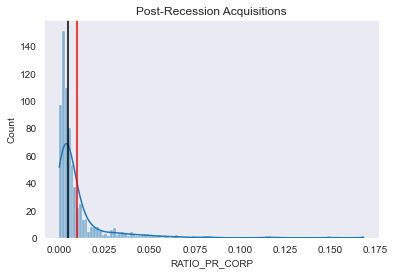

In [164]:
sns.histplot(x=tc_gdf['RATIO_PR_CORP'], kde=True)
plt.axvline(tc_gdf['RATIO_PR_CORP'].mean(), color = 'red')
plt.axvline(tc_gdf['RATIO_PR_CORP'].median(), color = 'k')
plt.title('Post-Recession Acquisitions')


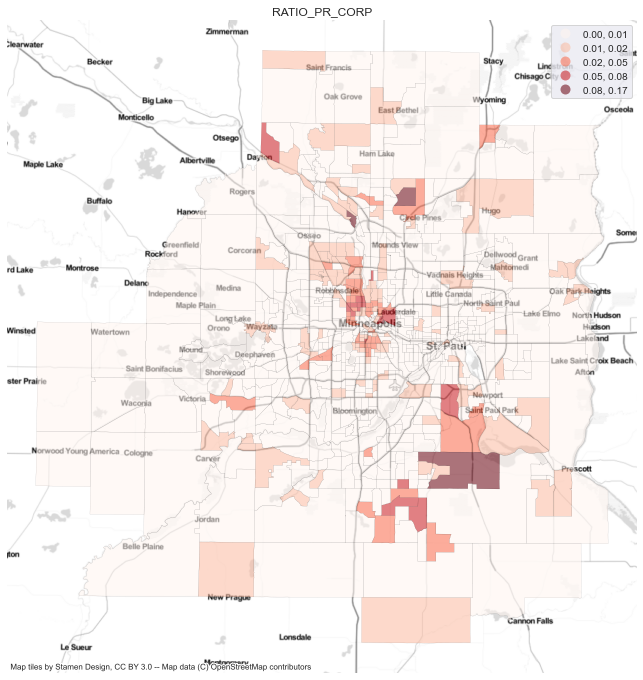

In [165]:
choro(tc_gdf, 'RATIO_PR_CORP')


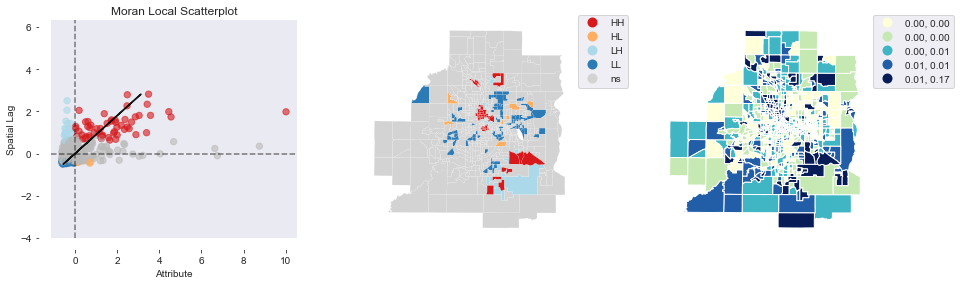

In [166]:
local_autocorrelation(tc_gdf, 'RATIO_PR_CORP')

In [167]:
tc_gdf_pcc = tc_gdf.drop(columns = ['PR_corp', 'RATIO_CORPSF', 'RATIO_QE_CORP', 'TR_SNGLFAM_CORP', 'RATIO_C19_CORP'])

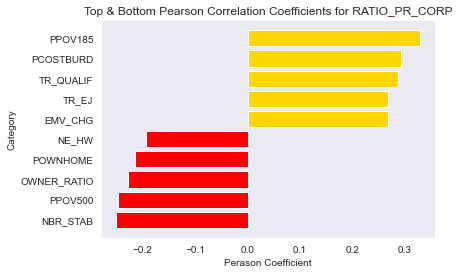

In [168]:
corr_pairs(tc_gdf_pcc, 'RATIO_PR_CORP')

QE Corporate Acquisitions

Text(0.5, 1.0, 'Quantitative Easing Acquistions')

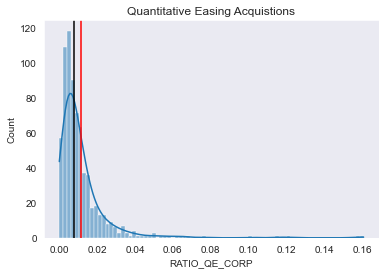

In [169]:
sns.histplot(x=tc_gdf['RATIO_QE_CORP'], kde=True)
plt.axvline(tc_gdf['RATIO_QE_CORP'].mean(), color = 'red')
plt.axvline(tc_gdf['RATIO_QE_CORP'].median(), color = 'k')
plt.title('Quantitative Easing Acquistions')

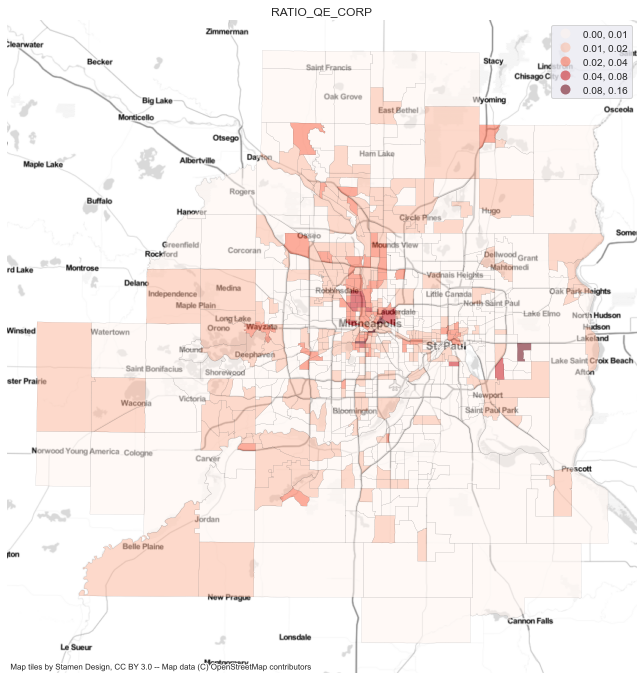

In [170]:
choro(tc_gdf, 'RATIO_QE_CORP')

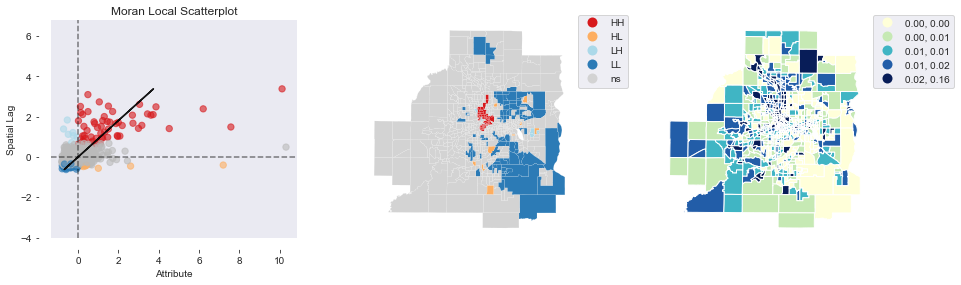

In [171]:
local_autocorrelation(tc_gdf, 'RATIO_QE_CORP')

In [172]:
tc_gdf_qec = tc_gdf.drop(columns = ['PR_corp', 'QE_corp', 'RATIO_CORPSF', 'TR_SNGLFAM_CORP', 'RATIO_C19_CORP', 'RATIO_PR_CORP'])

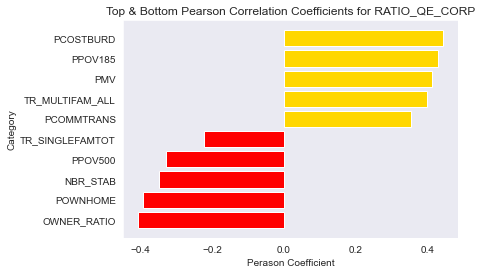

In [173]:
corr_pairs(tc_gdf_qec, 'RATIO_QE_CORP')

Post-Covid 19 Corporate Acquisitions

Text(0.5, 1.0, 'Covid 19 Corporate Acquisitions')

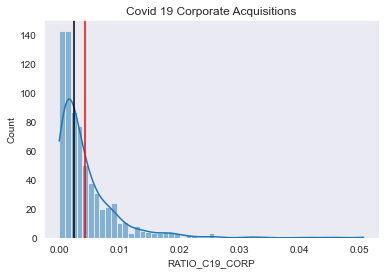

In [174]:
sns.histplot(x=tc_gdf['RATIO_C19_CORP'], kde=True)
plt.axvline(tc_gdf['RATIO_C19_CORP'].mean(), color = 'red')
plt.axvline(tc_gdf['RATIO_C19_CORP'].median(), color = 'k')
plt.title('Covid 19 Corporate Acquisitions')

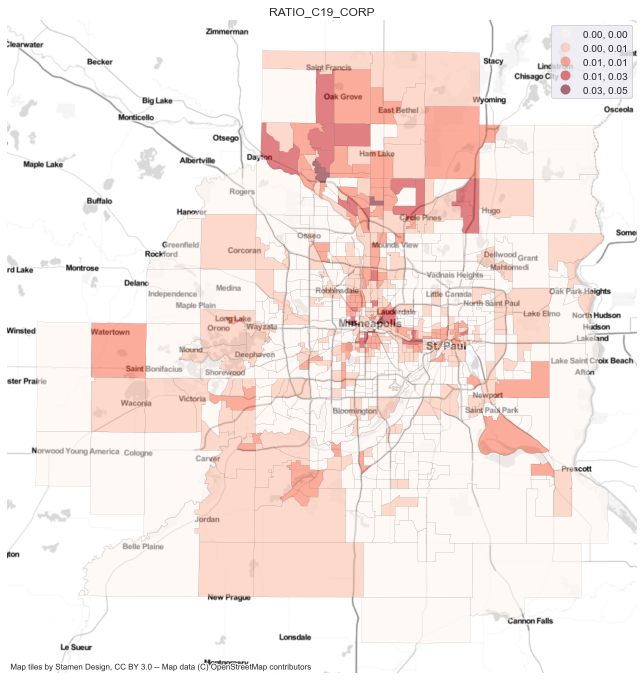

In [175]:
choro(tc_gdf, 'RATIO_C19_CORP')

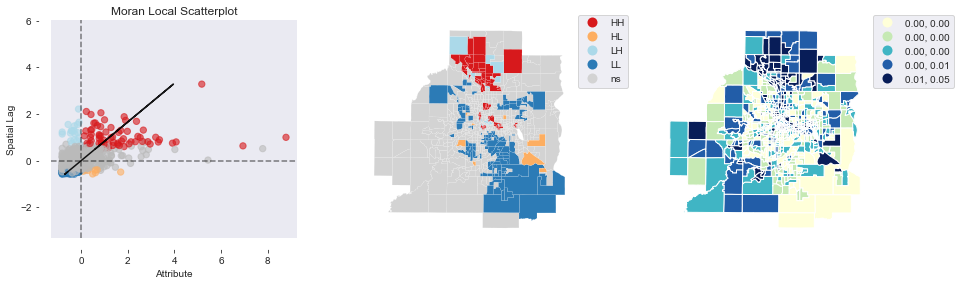

In [176]:
local_autocorrelation(tc_gdf, 'RATIO_C19_CORP')

In [177]:
tc_gdf_c19c = tc_gdf.drop(columns = ['PR_corp', 'QE_corp', 'C19_corp', 'RATIO_CORPSF', 'RATIO_QE_CORP', 'RATIO_PR_CORP'])

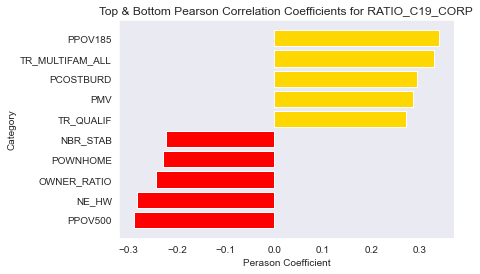

In [178]:
corr_pairs(tc_gdf_c19c, 'RATIO_C19_CORP')
